In [ ]:
#Importing all the necessary modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import itertools
from tqdm import tqdm
import random
from keras.utils.np_utils import to_categorical 
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from tensorflow.keras.optimizers import RMSprop, Adam
#from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from keras.preprocessing.image import ImageDataGenerator
import os
from PIL import Image, ImageChops, ImageEnhance
from IPython.display import display # to display images

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
!mkdir casia_dataset

In [ ]:

!unzip /content/drive/MyDrive/major_project/archive.zip -d casia_dataset

Streaming output truncated to the last 5000 lines.
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00008_nat10122_11773.jpg  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00045_arc00046_10084.tif  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00045_arc00071_10087.tif  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00046_arc00045_10083.tif  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00054_cha00085_11922.jpg  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00071_arc00045_10085.tif  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00073_arc00072_10267.tif  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_arc00088_arc00064_10394.tif  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_art00012_art00013_11812.jpg  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_art00014_art00013_11836.jpg  
  inflating: casia_dataset/casia/CASIA2/Tp/Tp_D_CRN_M_N_art00058_art00049_10529.tif  
  i

In [ ]:
!ls

casia_dataset  drive  sample_data


In [ ]:
#https://gist.github.com/cirocosta/33c758ad77e6e6531392
#error level analysis of an image
def ELA(img_path):
    TEMP = 'ela_' + 'temp.jpg'
    SCALE = 10
    original = Image.open(img_path)
    try:
        original.save(TEMP, quality=90)
        temporary = Image.open(TEMP)
        diff = ImageChops.difference(original, temporary)
        
    except:
        
        original.convert('RGB').save(TEMP, quality=90)
        temporary = Image.open(TEMP)
        diff = ImageChops.difference(original.convert('RGB'), temporary)
        
       
    d = diff.load()
    
    WIDTH, HEIGHT = diff.size
    for x in range(WIDTH):
        for y in range(HEIGHT):
            print(d[x,y])
            d[x, y] = tuple(k * SCALE for k in d[x, y])

    return diff

In [ ]:
#Au_ani_00068.jpg
#Tp_D_CND_S_N_ani00073_ani00068_00193.tif

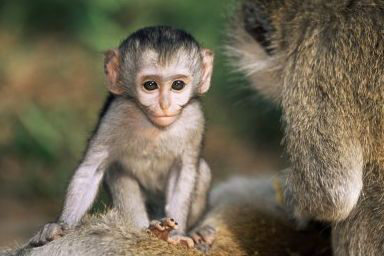

In [ ]:
from PIL import Image
orig_img = Image.open('/content/casia_dataset/CASIA1/Au/Au_ani_0068.jpg')
display(orig_img)


Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(2, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 2)
(1, 1, 2)
(1, 1, 2)
(1, 1, 2)
(2, 0, 3)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(3, 1, 1)
(1, 1, 1)
(1, 1, 3)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(1, 2, 1)
(1, 0, 3)
(1, 0, 3)
(1, 2, 1)
(1, 2, 1)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(1, 1, 1)
(2, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 2, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)

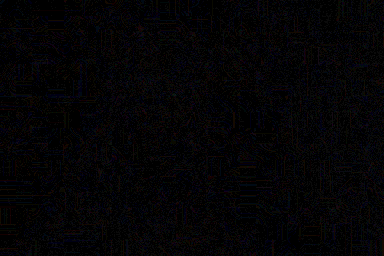

In [ ]:
ELA('/content/casia_dataset/CASIA1/Au/Au_ani_0068.jpg')

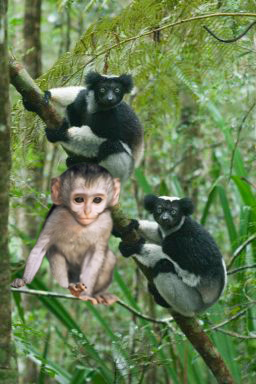

In [ ]:
tampered_img = Image.open('/content/casia_dataset/CASIA2/Tp/Tp_D_CND_S_N_ani00073_ani00068_00193.tif')
display(tampered_img)

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(0, 0, 2)
(2, 1, 2)
(0, 0, 2)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 0, 5)
(0, 1, 3)
(1, 2, 0)
(0, 0, 2)
(0, 1, 3)
(2, 0, 5)
(0, 1, 4)
(1, 1, 1)
(2, 0, 5)
(1, 3, 3)
(1, 2, 3)
(2, 2, 1)
(2, 1, 7)
(0, 1, 8)
(3, 0, 5)
(1, 1, 3)
(0, 0, 2)
(0, 1, 3)
(1, 2, 5)
(1, 2, 5)
(1, 1, 2)
(2, 0, 1)
(1, 0, 4)
(2, 0, 7)
(4, 1, 4)
(0, 1, 7)
(1, 2, 5)
(1, 0, 1)
(0, 0, 0)
(3, 0, 2)
(0, 1, 2)
(1, 1, 1)
(2, 1, 2)
(1, 1, 3)
(1, 1, 3)
(2, 2, 4)
(2, 1, 0)
(0, 0, 0)
(0, 1, 5)
(1, 1, 5)
(0, 1, 5)
(3, 2, 6)
(1, 1, 1)
(2, 1, 0)
(1, 1, 3)
(0, 1, 4)
(2, 1, 3)
(2, 1, 0)
(0, 0, 0)
(2, 0, 0)
(3, 1, 1)
(1, 1, 0)
(2, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 1, 2)
(2, 1, 0)
(1, 0, 0)
(1, 1, 0)
(4, 0, 1)
(2, 2, 1)
(1, 1, 0)
(1, 1, 2)
(1, 0, 1)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(1, 0, 2)
(3, 1, 1)
(1, 1, 2)
(0, 0, 0)
(1, 1, 0)
(1, 0, 2)
(1, 1, 3)
(2, 1, 0)
(0, 0, 0)
(1, 0, 2)
(2, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)

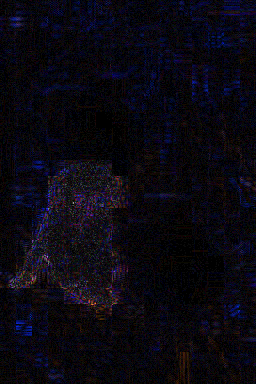

In [ ]:
ELA('/content/casia_dataset/CASIA2/Tp/Tp_D_CND_S_N_ani00073_ani00068_00193.tif')

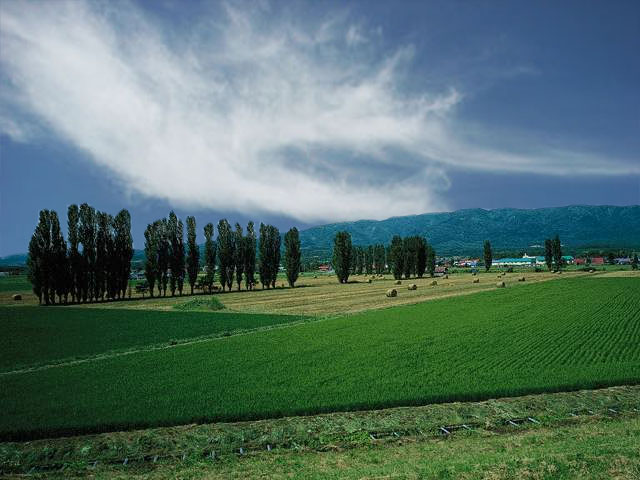

In [ ]:
#tampered image
Image.open('/content/casia_dataset/CASIA2/Tp/Tp_D_CRN_M_N_nat10131_nat10124_11906.jpg')

Streaming output truncated to the last 5000 lines.
(2, 3, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(2, 2, 0)
(3, 3, 3)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(2, 2, 2)
(3, 3, 3)
(1, 0, 3)
(1, 0, 3)
(0, 1, 2)
(1, 2, 1)
(2, 1, 4)
(2, 1, 4)
(1, 0, 3)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(0, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 2, 1)
(2, 2, 2)
(1, 1, 1)
(0, 1, 2)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(1, 1, 0)
(2, 0, 1)
(2, 2, 2)
(1, 1, 1)
(3, 0, 1)
(1, 2, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 3)
(0, 0, 0)

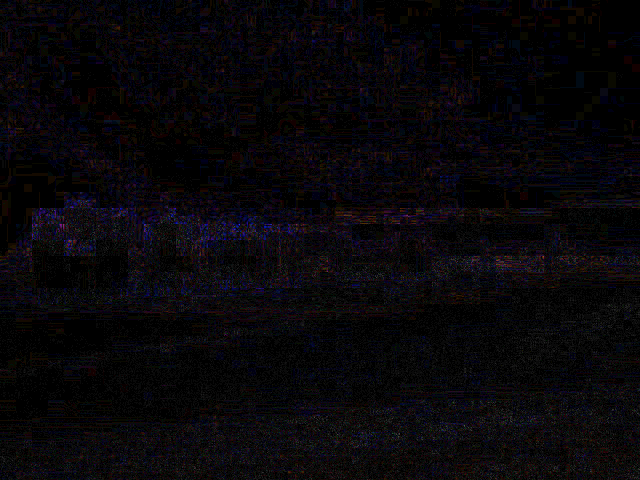

In [ ]:
ELA('/content/casia_dataset/CASIA2/Tp/Tp_D_CRN_M_N_nat10131_nat10124_11906.jpg')

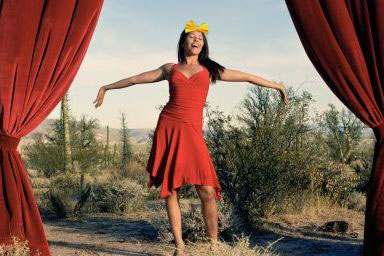

In [ ]:
Image.open('/content/casia_dataset/CASIA2/Tp/Tp_D_CRN_S_N_cha00063_art00014_11818.jpg')

Streaming output truncated to the last 5000 lines.
(4, 4, 1)
(5, 3, 3)
(1, 1, 1)
(2, 4, 6)
(0, 2, 2)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(0, 1, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(4, 2, 2)
(1, 2, 3)
(0, 0, 0)
(3, 2, 2)
(1, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 1, 3)
(1, 1, 1)
(1, 2, 1)
(2, 1, 4)
(3, 3, 3)
(2, 2, 2)
(1, 3, 3)
(1, 1, 0)
(1, 1, 0)
(1, 2, 5)
(1, 0, 2)
(3, 2, 2)
(1, 1, 1)
(1, 2, 1)
(1, 1, 1)
(3, 3, 3)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(2, 2, 0)
(1, 1, 1)
(2, 0, 1)
(2, 2, 4)
(1, 2, 1)
(3, 0, 1)
(0, 1, 3)
(2, 2, 2)
(1, 0, 3)
(1, 1, 1)
(2, 2, 4)
(2, 3, 5)
(2, 2, 2)
(2, 1, 3)
(2, 2, 2)
(1, 1, 1)
(3, 3, 3)
(2, 2, 2)
(3, 3, 3)
(5, 5, 5)
(1, 1, 3)
(1, 0, 4)
(2, 2, 2)
(1, 1, 1)
(2, 1, 4)
(0, 0, 1)
(2, 2, 2)
(2, 2, 4)
(2, 1, 4)
(1, 0, 3)
(1, 2, 4)
(1, 1, 3)
(3, 2, 4)
(3, 3, 5)
(2, 2, 0)
(0, 0, 2)
(0, 0, 0)
(4, 5, 5)
(0, 0, 0)
(3, 2, 2)
(2, 2, 2)
(2, 2, 2)
(1, 1, 1)
(2, 2, 2)
(1, 2, 1)
(0, 2, 3)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(2, 0, 0)

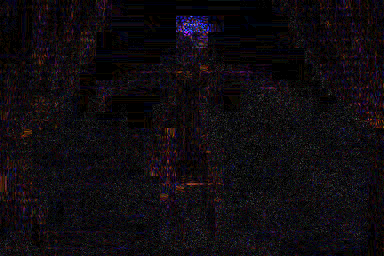

In [ ]:
ELA('/content/casia_dataset/CASIA2/Tp/Tp_D_CRN_S_N_cha00063_art00014_11818.jpg')

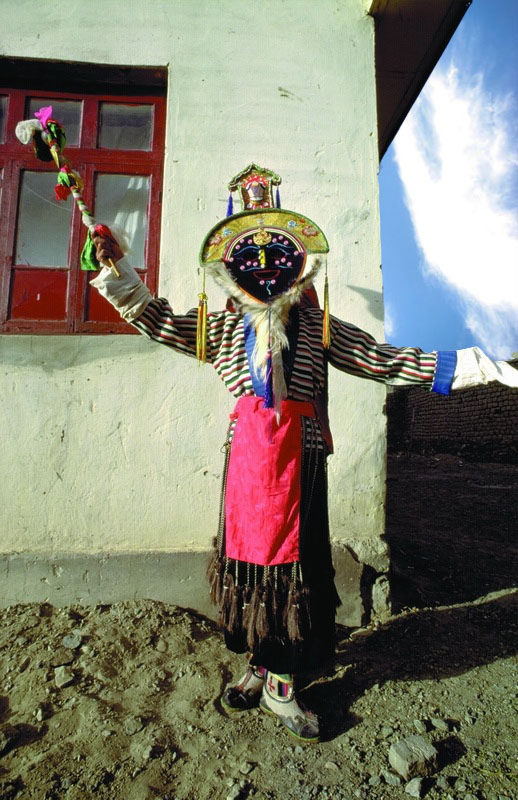

In [ ]:
Image.open('/content/casia_dataset/CASIA2/Tp/Tp_D_CRN_S_N_cha10122_nat10123_12168.jpg')

Streaming output truncated to the last 5000 lines.
(6, 3, 0)
(5, 0, 1)
(5, 1, 1)
(1, 0, 4)
(2, 1, 2)
(0, 2, 1)
(1, 1, 2)
(1, 0, 4)
(1, 1, 1)
(0, 0, 2)
(1, 1, 2)
(2, 2, 2)
(1, 1, 1)
(1, 0, 2)
(1, 1, 1)
(1, 1, 1)
(3, 0, 1)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(2, 0, 1)
(0, 2, 1)
(1, 1, 0)
(0, 1, 3)
(2, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(2, 1, 1)
(1, 3, 2)
(1, 1, 0)
(2, 1, 1)
(0, 0, 0)
(0, 2, 1)
(2, 2, 2)
(1, 1, 3)
(1, 0, 2)
(1, 0, 2)
(0, 1, 5)
(0, 0, 3)
(2, 0, 4)
(0, 0, 0)
(1, 1, 1)
(2, 3, 1)
(0, 1, 3)
(1, 2, 4)
(1, 1, 3)
(1, 1, 1)
(0, 1, 2)
(2, 2, 0)
(0, 0, 0)
(0, 1, 3)
(2, 2, 2)
(1, 1, 1)
(0, 0, 8)
(1, 0, 6)
(0, 1, 4)
(3, 3, 3)
(2, 1, 6)
(1, 2, 7)
(1, 0, 8)
(1, 1, 4)
(1, 1, 1)
(0, 0, 8)
(1, 0, 6)
(1, 0, 6)
(0, 1, 2)
(2, 2, 2)
(1, 2, 1)
(3, 4, 0)
(1, 1, 1)
(0, 0, 2)
(2, 2, 4)
(3, 1, 4)
(2, 1, 4)
(1, 2, 1)
(3, 2, 2)
(0, 2, 1)
(4, 0, 3)
(3, 1, 3)
(1, 0, 3)
(0, 2, 1)
(1, 1, 1)
(1, 0, 3)
(0, 1, 4)
(2, 2, 2)
(4, 5, 1)
(1, 1, 4)
(2, 2, 4)
(0, 1, 2)
(1, 0, 4)
(2, 1, 6)
(1, 4, 6)

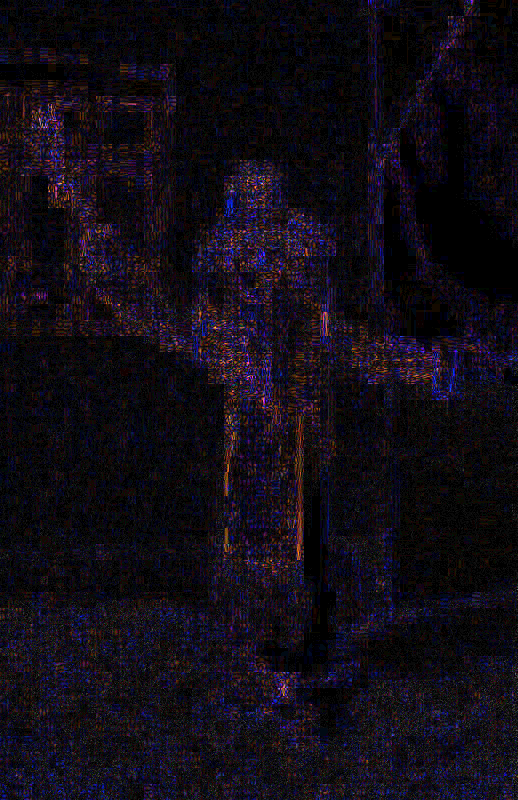

In [ ]:
ELA('/content/casia_dataset/CASIA2/Tp/Tp_D_CRN_S_N_cha10122_nat10123_12168.jpg')

In [ ]:
#Let's prepare the dataset 
path_original = '/content/casia_dataset/CASIA1/Au/'
path_tampered = '/content/casia_dataset/CASIA2/Tp/'

total_original = os.listdir(path_original)
total_tampered = os.listdir(path_tampered)
len(total_original)

800

In [ ]:
images = []

for file in tqdm(os.listdir(path_original)):
    try:
        if file.endswith('jpg'):
            if int(os.stat(path_original + file).st_size) > 10000:
                line = path_original + file  + ',0\n'
                images.append(line)
    except:
        print(path_original+file)

100%|██████████| 800/800 [00:00<00:00, 58376.85it/s]


In [ ]:
for file in tqdm(os.listdir(path_tampered)):
    try:
        if file.endswith('jpg'):
            if int(os.stat(path_tampered + file).st_size) > 10000:
                    line = path_tampered + file + ',1\n'
                    images.append(line)
        if file.endswith('tif'):
            if int(os.stat(path_tampered + file).st_size) > 10000:
                    line = path_tampered + file + ',1\n'
                    images.append(line)
    except:
          print(path_tampered+file)

100%|██████████| 5124/5124 [00:00<00:00, 75273.68it/s]


In [ ]:
len(images)

5905

In [ ]:
image_name = []
label = []
for i in tqdm(range(len(images))):
    image_name.append(images[i][0:-3])
    label.append(images[i][-2])
    

100%|██████████| 5905/5905 [00:00<00:00, 608878.85it/s]


In [ ]:
dataset = pd.DataFrame({'image':image_name,'class_label':label})
dataset['class_label'].value_counts()

1    5123
0     782
Name: class_label, dtype: int64

In [ ]:
dataset.head()

,image,class_label
0,/content/casia_dataset/CASIA1/Au/Au_arc_0087.jpg,0
1,/content/casia_dataset/CASIA1/Au/Au_nat_0067.jpg,0
2,/content/casia_dataset/CASIA1/Au/Au_nat_0037.jpg,0
3,/content/casia_dataset/CASIA1/Au/Au_pla_0064.jpg,0
4,/content/casia_dataset/CASIA1/Au/Au_art_0042.jpg,0


In [ ]:
dataset.to_csv('dataset_casa2.csv',index=False)

In [ ]:
dataset = pd.read_csv('dataset_casa2.csv')

In [ ]:
len(dataset)

5905

In [ ]:
x_casia = []
y_casia = []
for index, row in tqdm(dataset.iterrows()):
    x_casia.append(np.array(ELA(row[0]).resize((128, 128))).flatten() / 255.0)
    y_casia.append(row[1])

0it [00:00, ?it/s]

Streaming output truncated to the last 5000 lines.
(2, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 0, 0)
(1, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 0, 0)
(1, 1, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)

1it [00:39, 39.85s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 2)
(0, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(1, 1, 3)
(0, 0, 2)
(0, 0, 2)
(0, 1, 0)
(0, 1, 2)
(0, 0, 2)
(0, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 2)
(0, 0, 1)
(0, 0, 1)
(0, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 1, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 1, 2)
(0, 0, 1)
(0, 0, 2)
(0, 0, 2)

2it [01:20, 40.10s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(1, 1, 2)
(1, 1, 1)
(1, 2, 1)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(2, 1, 3)
(1, 1, 0)
(1, 1, 1)
(1, 1, 3)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(2, 1, 1)
(2, 0, 4)
(0, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(1, 2, 1)

3it [02:02, 41.00s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 3)
(1, 1, 1)
(3, 2, 2)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(3, 1, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(4, 4, 4)
(0, 0, 0)
(3, 1, 2)
(2, 2, 3)
(2, 1, 1)
(2, 2, 2)
(2, 0, 1)
(0, 0, 2)
(2, 3, 0)
(0, 0, 0)
(0, 0, 0)
(3, 3, 5)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(3, 0, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(3, 0, 3)
(2, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 0, 0)
(6, 1, 3)
(7, 1, 4)
(3, 8, 5)
(6, 3, 4)
(4, 4, 4)
(3, 1, 2)
(0, 3, 2)
(3, 1, 1)
(2, 0, 2)
(3, 2, 0)
(1, 1, 1)
(1, 1, 1)
(0, 1, 3)
(2, 2, 1)
(1, 1, 0)
(0, 2, 1)
(0, 1, 2)
(0, 0, 2)
(0, 2, 1)
(0, 2, 1)
(1, 1, 0)

4it [02:44, 41.37s/it]

Streaming output truncated to the last 5000 lines.
(2, 0, 1)
(4, 2, 3)
(0, 0, 0)
(1, 2, 1)
(2, 1, 0)
(1, 1, 1)
(0, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 1, 1)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(2, 2, 4)
(1, 1, 3)
(1, 0, 1)
(1, 1, 1)
(1, 1, 1)
(2, 1, 2)
(1, 1, 1)
(2, 2, 0)
(3, 0, 1)
(3, 0, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(1, 0, 3)
(1, 1, 1)
(1, 1, 0)
(0, 0, 2)
(1, 1, 3)
(1, 1, 3)
(0, 1, 2)
(3, 3, 3)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(2, 2, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)

5it [03:27, 41.94s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 0)
(0, 1, 0)
(1, 0, 2)
(1, 0, 3)
(0, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(1, 0, 3)
(0, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(1, 1, 2)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(1, 1, 2)
(0, 1, 2)
(0, 1, 2)
(2, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 2)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 2, 1)
(1, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)

6it [04:07, 41.37s/it]

Streaming output truncated to the last 5000 lines.
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

7it [04:49, 41.61s/it]

Streaming output truncated to the last 5000 lines.
(2, 2, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(2, 1, 1)
(2, 4, 3)
(3, 1, 2)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 0)
(0, 0, 2)
(1, 1, 3)
(1, 1, 1)
(1, 1, 2)
(1, 1, 2)
(0, 2, 3)
(2, 0, 1)
(1, 1, 2)
(3, 1, 0)
(1, 1, 2)
(1, 1, 2)
(1, 1, 1)
(1, 1, 3)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 2, 1)
(0, 0, 0)
(1, 1, 1)
(3, 1, 1)
(0, 2, 2)
(1, 1, 3)
(1, 1, 1)
(3, 0, 1)
(1, 1, 1)
(1, 1, 1)
(1, 0, 0)
(2, 0, 3)
(1, 3, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(1, 2, 1)
(1, 2, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(0, 2, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(3, 0, 1)
(0, 0, 0)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(2, 1, 2)
(1, 1, 3)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)

8it [05:34, 42.67s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

9it [06:17, 42.91s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)
(1, 2, 1)
(0, 1, 2)
(1, 0, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 0, 3)
(0, 1, 2)
(1, 2, 1)
(2, 1, 4)
(2, 2, 4)
(3, 1, 0)
(3, 1, 2)
(0, 0, 0)
(5, 2, 3)
(5, 3, 2)
(0, 3, 4)
(4, 1, 0)
(1, 1, 0)
(2, 1, 0)
(0, 0, 0)
(3, 2, 2)
(1, 3, 0)
(2, 2, 2)
(1, 1, 1)
(5, 2, 3)
(1, 1, 0)
(6, 4, 5)
(1, 1, 0)
(1, 7, 0)
(2, 1, 4)
(4, 3, 4)
(3, 3, 1)
(2, 2, 4)
(4, 4, 4)
(7, 4, 5)
(2, 2, 2)
(5, 7, 6)
(1, 1, 1)
(2, 0, 3)
(1, 1, 0)
(1, 3, 6)
(7, 7, 0)
(4, 4, 4)
(5, 5, 0)
(4, 4, 2)
(0, 1, 2)
(5, 5, 7)
(2, 2, 0)
(1, 1, 1)
(6, 6, 6)
(1, 1, 1)
(4, 3, 6)
(2, 2, 4)
(11, 13, 4)
(4, 4, 4)
(4, 4, 4)
(3, 0, 1)
(0, 2, 3)
(3, 1, 0)
(1, 0, 2)
(2, 2, 4)
(2, 2, 2)
(1, 1, 1)
(2, 3, 0)
(3, 1, 2)
(1, 3, 2)
(1, 1, 0)
(4, 4, 4)
(2, 0, 0)
(0, 0, 1)
(4, 2, 4)
(1, 1, 0)
(4, 4, 4)
(2, 0, 3)
(2, 5, 1)
(3, 3, 4)
(0, 0, 0)
(7, 8, 0)
(2, 2, 2)
(2, 2, 0)
(1, 0, 0)
(1, 1, 2)
(7, 10, 10)
(2, 2, 4)
(4, 4

10it [07:00, 42.95s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 5)
(3, 1, 3)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 1, 4)
(1, 0, 9)
(2, 0, 0)
(0, 1, 3)
(0, 1, 3)
(0, 1, 2)
(2, 0, 0)
(0, 0, 0)
(0, 2, 1)
(0, 1, 1)
(0, 1, 4)
(0, 1, 4)
(1, 1, 2)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 2)
(0, 1, 4)
(0, 1, 0)
(0, 0, 1)
(0, 1, 4)
(0, 0, 3)
(1, 2, 2)
(1, 2, 4)
(0, 1, 2)
(1, 1, 3)
(1, 1, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 3)
(0, 0, 2)
(1, 1, 0)
(0, 2, 0)
(1, 2, 4)
(1, 1, 0)
(1, 1, 1)
(1, 2, 3)
(0, 1, 6)
(0, 0, 2)
(1, 1, 2)
(0, 1, 3)
(1, 1, 7)
(1, 1, 4)
(1, 0, 5)
(2, 0, 3)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 3)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(2, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(1, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 1, 4)
(0, 0, 3)
(0, 1, 3)
(1, 1, 5)
(0, 1, 4)
(1, 1, 4)
(1, 1, 5)
(2, 0, 1)
(2, 1, 1)
(0, 0, 0)
(3, 0, 3)
(1, 1, 2)
(1, 0, 3)
(0, 1, 2)
(2, 0, 0)
(1, 1, 0)

11it [07:45, 43.50s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 3)
(1, 1, 1)
(2, 2, 3)
(0, 0, 0)
(0, 0, 0)
(3, 3, 1)
(0, 1, 2)
(1, 1, 1)
(3, 0, 1)
(4, 2, 3)
(3, 1, 1)
(3, 1, 2)
(1, 0, 0)
(1, 0, 2)
(4, 1, 2)
(1, 3, 2)
(2, 1, 0)
(2, 2, 2)
(1, 3, 2)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(2, 0, 2)
(6, 6, 6)
(3, 3, 3)
(3, 2, 5)
(3, 3, 3)
(0, 0, 2)
(1, 1, 1)
(2, 2, 2)
(0, 2, 1)
(2, 0, 1)
(3, 3, 3)
(5, 5, 3)
(2, 1, 0)
(4, 4, 4)
(2, 2, 2)
(0, 1, 0)
(2, 2, 2)
(1, 3, 2)
(3, 3, 5)
(5, 5, 5)
(2, 5, 4)
(0, 0, 0)
(7, 7, 7)
(3, 3, 3)
(0, 0, 2)
(1, 2, 1)
(0, 1, 2)
(3, 0, 1)
(2, 4, 3)
(7, 6, 6)
(5, 5, 6)
(1, 1, 1)
(3, 3, 3)
(5, 3, 4)
(0, 2, 1)
(2, 2, 3)
(0, 0, 1)
(5, 6, 2)
(1, 0, 3)
(1, 1, 1)
(2, 1, 0)
(3, 5, 6)
(1, 0, 2)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(2, 3, 3)
(3, 2, 0)
(0, 3, 4)
(2, 0, 2)
(4, 2, 2)
(2, 2, 2)
(1, 2, 1)
(3, 1, 0)
(1, 1, 3)
(2, 1, 1)
(2, 2, 0)
(4, 4, 2)
(4, 4, 2)
(1, 0, 1)
(3, 3, 1)
(1, 0, 3)
(1, 2, 4)
(0, 0, 0)
(4, 4, 4)
(2, 0, 1)
(9, 6, 7)
(5, 5, 7)
(3, 0, 1)
(3, 2, 4)
(1, 1, 1)
(2, 0, 1)
(3, 1, 2)

12it [08:30, 43.95s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

13it [09:10, 42.63s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 2)
(0, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 1, 1)
(0, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 3)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)

14it [09:51, 42.30s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

15it [10:34, 42.51s/it]

Streaming output truncated to the last 5000 lines.
(1, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(2, 0, 0)
(2, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 2, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 0, 3)
(2, 1, 2)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

16it [11:17, 42.64s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(1, 1, 1)
(1, 1, 2)
(2, 2, 2)
(0, 0, 0)
(1, 0, 3)
(1, 4, 5)
(1, 1, 3)
(2, 2, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 3)
(2, 2, 4)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 2, 0)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(4, 4, 4)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(2, 0, 2)
(2, 2, 2)
(1, 1, 1)
(3, 3, 1)
(1, 1, 3)
(1, 1, 1)
(1, 1, 2)
(0, 0, 0)
(1, 1, 0)
(4, 4, 4)
(5, 2, 3)
(1, 4, 1)
(6, 3, 5)
(3, 3, 2)
(1, 1, 0)
(1, 0, 1)
(3, 3, 3)
(4, 4, 4)
(3, 3, 3)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(3, 5, 4)
(0, 3, 2)
(3, 1, 2)
(2, 4, 3)
(2, 2, 3)
(4, 3, 6)
(0, 0, 0)
(0, 0, 2)
(3, 3, 3)
(3, 3, 3)
(0, 0, 0)
(3, 3, 3)
(0, 0, 0)
(2, 2, 2)
(4, 5, 2)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(4, 4, 4)
(2, 2, 2)
(1, 0, 0)
(3, 5, 4)
(3, 5, 4)
(3, 2, 5)
(6, 6, 6)
(8, 8, 8)
(2, 1, 2)
(1, 1, 1)
(2, 3, 1)
(5, 5, 5)
(1, 1, 1)
(2, 2, 2)
(4, 4, 4)
(2, 2, 2)
(3, 3, 3)
(2, 2, 3)
(2, 2, 0)
(5, 5, 5)
(1, 4, 3)
(1, 1, 3)

17it [11:56, 41.65s/it]

Streaming output truncated to the last 5000 lines.
(1, 3, 0)
(1, 2, 1)
(1, 1, 1)
(1, 1, 1)
(0, 2, 1)
(1, 1, 3)
(1, 1, 0)
(0, 3, 2)
(2, 2, 2)
(0, 0, 2)
(1, 1, 3)
(3, 3, 1)
(3, 3, 3)
(1, 3, 2)
(1, 1, 2)
(0, 0, 2)
(0, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 1, 1)
(0, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 0, 2)
(1, 0, 3)
(1, 1, 1)
(1, 1, 0)
(2, 2, 2)
(0, 1, 2)
(1, 1, 1)
(2, 0, 1)
(2, 2, 6)
(0, 0, 0)
(1, 1, 1)
(3, 3, 3)
(1, 1, 2)
(4, 4, 6)
(1, 2, 1)
(3, 3, 3)
(5, 3, 2)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 2, 3)
(3, 1, 1)
(2, 0, 0)
(4, 1, 0)
(2, 0, 1)
(1, 1, 3)
(0, 1, 2)
(0, 3, 4)
(3, 3, 1)
(4, 4, 4)
(1, 2, 1)
(2, 1, 4)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(2, 3, 0)
(2, 1, 0)
(0, 1, 2)
(1, 1, 1)
(4, 3, 5)
(1, 4, 1)
(2, 1, 4)
(2, 2, 2)
(4, 2, 5)
(0, 0, 0)
(1, 0, 3)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 0, 2)
(1, 1, 0)
(0, 1, 1)
(0, 0, 2)
(2, 0, 2)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(3, 3, 3)
(3, 1, 2)
(1, 3, 0)
(6, 3, 6)
(2, 2, 1)

18it [12:38, 41.69s/it]

Streaming output truncated to the last 5000 lines.
(4, 5, 5)
(3, 3, 1)
(1, 3, 9)
(6, 3, 4)
(3, 2, 7)
(3, 1, 4)
(3, 5, 8)
(3, 6, 14)
(6, 1, 11)
(0, 4, 3)
(0, 4, 1)
(2, 5, 4)
(7, 3, 4)
(4, 0, 2)
(5, 10, 12)
(10, 5, 1)
(1, 0, 10)
(3, 4, 2)
(5, 0, 4)
(1, 1, 1)
(1, 6, 0)
(12, 0, 12)
(4, 3, 12)
(2, 1, 12)
(0, 2, 2)
(2, 3, 2)
(1, 4, 1)
(4, 0, 7)
(1, 4, 6)
(5, 4, 6)
(3, 6, 15)
(8, 1, 9)
(3, 4, 9)
(5, 1, 1)
(3, 1, 5)
(0, 0, 8)
(4, 1, 4)
(4, 1, 0)
(3, 1, 1)
(4, 1, 7)
(4, 9, 6)
(5, 7, 5)
(3, 5, 0)
(3, 2, 2)
(5, 2, 10)
(7, 4, 6)
(2, 10, 4)
(11, 1, 0)
(7, 2, 16)
(8, 6, 11)
(11, 6, 1)
(10, 4, 6)
(8, 1, 6)
(8, 2, 2)
(2, 1, 8)
(5, 7, 7)
(1, 4, 3)
(6, 2, 4)
(15, 2, 4)
(8, 0, 3)
(11, 5, 1)
(14, 2, 5)
(9, 5, 0)
(2, 4, 4)
(3, 4, 3)
(4, 2, 0)
(16, 4, 3)
(12, 4, 1)
(1, 5, 4)
(3, 1, 12)
(1, 8, 5)
(2, 3, 9)
(10, 3, 11)
(13, 4, 0)
(14, 4, 10)
(8, 5, 11)
(1, 1, 7)
(8, 5, 2)
(12, 5, 13)
(5, 2, 17)
(0, 2, 11)
(11, 3, 6)
(13, 7, 16)
(6, 7, 12)
(1, 1, 11)
(1, 2, 6)
(10, 2, 16)
(1, 11, 4)
(11, 5, 16)
(6, 6, 10)
(2, 

19it [13:22, 42.22s/it]

Streaming output truncated to the last 5000 lines.
(2, 1, 2)
(0, 2, 0)
(2, 1, 0)
(2, 0, 1)
(1, 1, 2)
(1, 1, 3)
(2, 1, 0)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(1, 1, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 3)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 1, 1)
(0, 0, 0)
(0, 1, 2)
(1, 0, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(0, 0, 0)

20it [14:06, 42.85s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(0, 0, 0)
(0, 1, 0)
(0, 0, 1)
(0, 0, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)

21it [14:50, 43.19s/it]

Streaming output truncated to the last 5000 lines.
(2, 2, 2)
(0, 0, 2)
(0, 0, 0)
(1, 2, 1)
(1, 1, 0)
(2, 1, 4)
(2, 1, 0)
(3, 3, 2)
(2, 0, 1)
(0, 5, 3)
(2, 3, 1)
(0, 0, 0)
(2, 1, 2)
(3, 2, 2)
(1, 3, 2)
(3, 0, 1)
(5, 5, 5)
(2, 3, 0)
(0, 0, 0)
(0, 1, 0)
(1, 1, 1)
(2, 1, 0)
(1, 3, 0)
(0, 2, 1)
(3, 1, 1)
(1, 1, 2)
(0, 0, 0)
(2, 2, 1)
(2, 1, 0)
(0, 1, 0)
(2, 0, 0)
(0, 1, 2)
(1, 0, 1)
(1, 1, 1)
(2, 1, 2)
(1, 1, 2)
(2, 1, 0)
(1, 0, 2)
(0, 1, 1)
(0, 2, 1)
(1, 2, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(0, 1, 2)
(1, 1, 2)
(1, 1, 2)
(0, 0, 2)
(0, 1, 0)
(2, 0, 3)
(0, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(2, 0, 3)
(1, 2, 0)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(3, 0, 2)
(0, 2, 1)
(2, 2, 1)
(0, 2, 1)
(1, 1, 0)
(0, 2, 0)
(4, 4, 4)
(1, 1, 1)
(2, 2, 4)
(3, 3, 3)
(2, 0, 2)
(2, 0, 2)
(0, 1, 1)
(2, 1, 2)
(0, 2, 1)
(1, 1, 0)
(2, 1, 0)
(2, 1, 0)
(1, 2, 1)
(2, 1, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 2)
(2, 1, 1)
(2, 1, 0)
(2, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(3, 1, 1)
(2, 0, 3)

22it [15:35, 43.70s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

23it [16:18, 43.54s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

24it [17:02, 43.56s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

25it [17:45, 43.50s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 2, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)

26it [18:28, 43.30s/it]

Streaming output truncated to the last 5000 lines.
(1, 3, 2)
(3, 3, 3)
(4, 2, 3)
(3, 1, 0)
(4, 6, 7)
(1, 0, 2)
(1, 2, 4)
(0, 0, 2)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(1, 0, 0)
(0, 1, 1)
(0, 0, 0)
(1, 1, 3)
(1, 1, 1)
(1, 1, 1)
(2, 1, 1)
(0, 0, 1)
(1, 1, 2)
(0, 2, 1)
(2, 0, 3)
(0, 0, 2)
(2, 2, 0)
(0, 1, 3)
(1, 0, 2)
(2, 1, 2)
(1, 2, 3)
(2, 1, 2)
(1, 0, 2)
(0, 1, 3)
(2, 1, 2)
(1, 1, 3)
(1, 1, 3)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(2, 1, 0)
(1, 2, 1)
(1, 1, 2)
(0, 0, 2)
(1, 1, 1)
(2, 2, 2)
(0, 1, 1)
(1, 0, 2)
(1, 1, 0)
(1, 1, 1)
(2, 0, 1)
(3, 1, 1)
(1, 0, 3)
(2, 1, 0)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(2, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)

27it [19:11, 43.09s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(4, 4, 4)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(3, 3, 3)
(4, 4, 4)
(2, 0, 1)
(2, 2, 2)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(0, 2, 1)
(0, 2, 2)
(3, 4, 1)
(5, 4, 7)
(3, 4, 1)
(4, 4, 4)
(3, 3, 3)
(0, 0, 0)
(2, 2, 2)

28it [19:53, 42.83s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

29it [20:35, 42.73s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 1, 2)
(0, 1, 1)
(0, 1, 2)
(0, 0, 1)
(0, 1, 1)
(0, 0, 4)
(0, 0, 2)
(0, 1, 2)
(0, 1, 2)
(0, 1, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

30it [21:18, 42.70s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(1, 2, 3)
(0, 0, 0)
(1, 1, 0)
(0, 1, 1)
(0, 0, 0)
(1, 1, 3)
(1, 1, 3)
(1, 0, 5)
(1, 1, 4)
(0, 1, 3)
(1, 0, 5)
(1, 0, 0)
(1, 1, 2)
(0, 0, 2)
(0, 1, 4)
(1, 0, 0)
(1, 0, 0)
(1, 1, 0)
(0, 1, 0)
(0, 1, 3)
(0, 1, 2)
(2, 0, 2)
(0, 0, 2)
(0, 1, 3)
(0, 0, 1)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 0)
(1, 0, 3)
(2, 0, 1)
(1, 1, 0)
(2, 0, 0)
(1, 1, 3)
(1, 1, 3)
(1, 1, 3)
(2, 0, 1)
(1, 0, 2)
(0, 1, 2)
(0, 0, 2)
(0, 1, 0)
(0, 1, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 1)
(1, 0, 3)
(0, 0, 0)
(0, 1, 2)
(1, 1, 0)
(1, 0, 2)
(1, 0, 3)
(0, 1, 3)
(0, 0, 0)
(1, 0, 2)
(0, 0, 2)
(0, 0, 2)
(1, 0, 2)
(0, 1, 0)
(2, 2, 0)
(2, 2, 4)
(0, 1, 2)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 2, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)

31it [22:01, 42.80s/it]

Streaming output truncated to the last 5000 lines.
(2, 2, 0)
(6, 6, 6)
(2, 2, 2)
(2, 2, 2)
(4, 4, 4)
(5, 5, 3)
(1, 1, 1)
(4, 4, 4)
(1, 1, 1)
(3, 3, 3)
(1, 1, 0)
(0, 2, 2)
(0, 2, 1)
(5, 7, 6)
(9, 8, 8)
(2, 0, 1)
(0, 1, 3)
(3, 2, 5)
(6, 3, 4)
(3, 6, 5)
(0, 0, 0)
(2, 2, 2)
(0, 1, 1)
(0, 0, 0)
(0, 0, 2)
(3, 1, 5)
(1, 2, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(2, 2, 2)
(1, 1, 1)
(3, 3, 3)
(1, 1, 1)
(1, 1, 1)
(3, 4, 1)
(4, 2, 3)
(3, 6, 3)
(1, 1, 1)
(1, 1, 1)
(2, 4, 3)
(2, 0, 0)
(3, 2, 2)
(2, 4, 5)
(6, 4, 3)
(1, 3, 0)
(3, 1, 2)
(3, 1, 1)
(0, 3, 2)
(5, 3, 4)
(2, 2, 2)
(5, 5, 5)
(2, 2, 2)
(2, 2, 0)
(7, 7, 7)
(3, 5, 4)
(6, 6, 6)
(1, 1, 0)
(2, 2, 2)
(4, 1, 2)
(1, 1, 1)
(2, 3, 0)
(3, 3, 1)
(2, 0, 3)
(4, 5, 3)
(2, 2, 4)
(3, 4, 1)
(3, 3, 5)
(4, 4, 4)
(4, 4, 4)
(5, 5, 5)
(1, 1, 0)
(3, 2, 1)
(0, 2, 5)
(2, 1, 4)
(4, 5, 0)
(3, 2, 0)
(3, 3, 0)
(6, 6, 6)
(1, 1, 1)
(8, 6, 9)

32it [22:44, 42.95s/it]

Streaming output truncated to the last 5000 lines.
(2, 0, 1)
(1, 1, 1)
(2, 1, 1)
(0, 0, 0)
(1, 0, 2)
(2, 0, 0)
(4, 1, 2)
(0, 2, 3)
(0, 1, 3)
(0, 0, 1)
(4, 1, 1)
(3, 1, 0)
(4, 3, 3)
(2, 2, 3)
(3, 1, 0)
(0, 2, 3)
(1, 2, 2)
(2, 1, 0)
(0, 3, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 0, 0)
(1, 1, 0)
(3, 0, 4)
(0, 1, 1)
(0, 1, 1)
(2, 2, 2)
(2, 0, 1)
(1, 1, 0)
(2, 0, 0)
(0, 1, 1)
(1, 1, 1)
(0, 2, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 1, 2)
(0, 0, 2)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(2, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 2)
(2, 1, 2)
(0, 0, 2)
(0, 0, 2)
(1, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(1, 1, 0)
(1, 1, 1)
(2, 1, 0)
(2, 1, 0)
(2, 3, 1)
(3, 1, 0)
(3, 1, 0)
(2, 1, 0)
(0, 0, 1)
(1, 1, 1)
(1, 1, 2)
(0, 1, 1)
(3, 1, 0)
(1, 0, 0)
(2, 0, 2)
(0, 1, 3)
(1, 3, 2)
(2, 0, 1)
(2, 0, 1)
(0, 1, 1)
(3, 1, 0)

33it [23:27, 43.03s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 0, 0)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

34it [24:11, 43.18s/it]

Streaming output truncated to the last 5000 lines.
(1, 2, 1)
(0, 0, 1)
(1, 1, 1)
(0, 0, 0)
(1, 0, 3)
(0, 1, 4)
(0, 0, 2)
(0, 1, 2)
(1, 0, 3)
(2, 2, 2)
(1, 0, 1)
(4, 4, 6)
(0, 1, 2)
(4, 2, 0)
(1, 1, 2)
(3, 0, 1)
(3, 0, 1)
(7, 4, 7)
(4, 0, 5)
(0, 1, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 0, 2)
(1, 2, 1)
(1, 2, 1)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 2)
(2, 2, 2)
(0, 1, 1)
(4, 0, 1)
(1, 2, 1)
(2, 0, 1)
(1, 2, 4)
(3, 0, 1)
(1, 0, 2)
(3, 3, 3)
(2, 0, 1)
(1, 1, 1)
(1, 1, 3)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 1, 0)
(1, 1, 1)
(1, 1, 0)
(2, 2, 2)
(8, 5, 6)
(4, 5, 5)
(4, 6, 3)
(1, 1, 3)
(0, 3, 2)
(9, 7, 5)
(2, 0, 0)
(2, 2, 2)
(1, 1, 1)
(3, 4, 1)
(1, 2, 1)
(1, 1, 3)
(3, 4, 4)
(4, 1, 2)
(1, 1, 1)
(2, 2, 2)
(4, 4, 4)
(3, 0, 1)

35it [24:56, 43.60s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(1, 1, 1)
(3, 1, 4)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 1, 1)
(4, 2, 2)
(0, 3, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(1, 0, 2)
(0, 0, 0)
(2, 1, 0)
(2, 1, 0)
(2, 1, 0)
(1, 1, 2)
(1, 1, 2)
(1, 1, 0)
(2, 0, 3)
(1, 0, 0)
(2, 1, 1)
(0, 0, 1)
(0, 0, 1)
(0, 1, 1)
(0, 0, 1)
(1, 0, 2)
(2, 1, 0)
(1, 1, 2)
(1, 1, 0)
(3, 1, 0)
(2, 1, 0)
(3, 0, 2)
(1, 2, 3)
(0, 0, 2)
(0, 0, 1)
(0, 0, 2)
(3, 0, 0)
(1, 2, 1)
(2, 0, 0)
(3, 3, 2)
(4, 6, 6)
(0, 3, 4)
(5, 1, 1)
(2, 2, 3)
(2, 2, 1)
(3, 1, 0)
(3, 2, 2)
(2, 2, 2)
(2, 0, 2)
(1, 1, 1)
(0, 1, 2)
(1, 1, 0)
(0, 0, 2)
(0, 0, 1)
(1, 2, 1)
(1, 1, 1)
(1, 1, 1)
(1, 0, 3)
(2, 1, 2)
(2, 1, 2)
(1, 1, 1)
(1, 1, 1)
(2, 1, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(3, 1, 1)
(2, 2, 2)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 2)
(2, 1, 0)
(1, 1, 3)
(0, 0, 2)
(0, 1, 2)
(1, 0, 3)
(0, 0, 0)
(0, 0, 0)

36it [25:40, 43.77s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 0, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(2, 0, 1)
(1, 0, 2)
(1, 0, 1)
(1, 1, 0)
(1, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 2)
(2, 1, 0)
(0, 0, 2)
(1, 0, 2)
(0, 0, 0)
(2, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(2, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)

37it [26:23, 43.62s/it]

Streaming output truncated to the last 5000 lines.
(2, 2, 3)
(1, 1, 0)
(2, 1, 4)
(1, 1, 1)
(1, 1, 1)
(3, 2, 4)
(7, 4, 7)
(0, 0, 0)
(0, 0, 0)
(5, 5, 5)
(6, 6, 8)
(6, 7, 0)
(5, 5, 0)
(3, 5, 6)
(5, 3, 4)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(2, 2, 1)
(1, 2, 1)
(3, 3, 3)
(3, 2, 5)
(1, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

38it [27:08, 44.00s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 2)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(2, 1, 4)
(2, 0, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 1)
(0, 2, 1)
(1, 1, 0)
(1, 1, 0)
(0, 2, 1)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 2)
(0, 0, 0)
(3, 0, 1)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 0, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(3, 1, 4)

39it [27:51, 43.83s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(0, 0, 2)
(0, 0, 1)
(0, 1, 2)
(0, 0, 4)
(0, 0, 1)
(0, 0, 2)
(0, 1, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(0, 0, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 2, 1)
(0, 1, 2)
(0, 0, 1)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(0, 0, 1)
(0, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 3)
(0, 0, 2)
(1, 1, 3)
(0, 0, 0)
(0, 0, 1)
(1, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

40it [28:35, 43.71s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(0, 1, 1)
(1, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 0)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 2)
(0, 0, 1)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 2, 3)
(1, 1, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 1)
(0, 0, 0)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)

41it [29:19, 44.02s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(3, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 3)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(2, 0, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(3, 1, 1)
(1, 1, 1)
(0, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(1, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)

42it [30:03, 43.79s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 0)
(0, 0, 0)
(2, 2, 2)
(0, 0, 2)
(2, 2, 2)
(2, 1, 0)
(1, 1, 1)
(2, 2, 4)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 2, 1)
(0, 1, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(1, 1, 1)
(1, 1, 1)
(2, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 0, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)

43it [30:48, 44.14s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

44it [31:30, 43.75s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 3)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(2, 2, 2)
(2, 0, 0)
(2, 2, 3)
(3, 2, 2)
(0, 0, 0)
(3, 0, 1)
(3, 3, 3)
(3, 5, 4)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(0, 1, 1)
(0, 0, 1)
(1, 3, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(2, 0, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(3, 0, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 0, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(3, 3, 3)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(2, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(1, 1, 3)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 2)
(1, 1, 0)
(0, 2, 1)
(0, 2, 1)
(1, 1, 0)
(2, 0, 1)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)

45it [32:14, 43.68s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 2)
(2, 0, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 2, 1)
(1, 0, 2)
(1, 1, 0)
(1, 1, 1)
(1, 0, 5)
(0, 0, 2)
(1, 1, 2)
(0, 1, 5)
(0, 2, 3)
(1, 2, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 0, 3)
(0, 0, 0)
(1, 1, 2)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 1, 3)
(3, 0, 4)
(2, 1, 2)
(3, 0, 3)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(1, 2, 1)
(0, 1, 3)
(1, 1, 1)
(2, 1, 1)
(2, 1, 1)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(1, 1, 1)
(1, 1, 0)
(2, 1, 0)
(3, 1, 2)
(0, 1, 2)
(1, 1, 1)
(0, 0, 2)
(2, 1, 4)
(0, 0, 0)
(1, 3, 1)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(1, 1, 3)
(1, 1, 3)
(1, 1, 1)
(1, 1, 1)
(2, 3, 0)
(2, 3, 0)
(1, 2, 1)
(1, 2, 4)
(1, 1, 2)
(0, 2, 1)
(2, 2, 4)
(2, 2, 2)
(1, 1, 1)
(2, 1, 1)
(1, 1, 1)
(2, 1, 4)
(2, 2, 4)
(1, 1, 1)
(2, 1, 5)
(1, 4, 2)
(3, 0, 2)
(1, 4, 1)
(3, 3, 3)
(1, 2, 1)
(0, 0, 0)
(1, 0, 3)
(2, 1, 4)
(2, 2, 2)
(1, 1, 3)
(2, 2, 2)
(4, 4, 2)
(0, 0, 2)
(0, 0, 0)
(2, 2, 2)

46it [32:58, 43.80s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(0, 1, 1)
(1, 0, 0)
(1, 0, 0)
(1, 0, 0)
(0, 1, 1)
(1, 0, 0)
(1, 0, 0)
(2, 1, 1)
(1, 0, 0)
(1, 0, 0)
(0, 1, 1)
(1, 0, 0)
(1, 0, 0)
(2, 1, 1)
(1, 0, 0)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 4, 5)
(3, 3, 3)
(1, 3, 2)
(4, 4, 3)
(2, 3, 0)
(0, 0, 2)
(0, 0, 2)
(2, 5, 1)
(2, 0, 4)
(4, 1, 4)
(1, 2, 1)
(0, 0, 0)
(1, 1, 0)
(1, 3, 2)
(1, 1, 1)
(4, 1, 2)
(1, 1, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 2, 1)
(1, 2, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 2, 1)
(1, 2, 1)
(1, 2, 1)
(1, 2, 1)
(2, 0, 0)
(2, 0, 0)
(1, 1, 1)
(1, 2, 1)

47it [33:42, 43.79s/it]

Streaming output truncated to the last 5000 lines.
(2, 0, 1)
(2, 1, 1)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(1, 2, 1)
(2, 1, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 3)
(0, 1, 2)
(2, 1, 2)
(2, 1, 0)
(3, 1, 1)
(2, 0, 0)
(1, 0, 2)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(3, 0, 1)
(1, 1, 1)
(1, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 0, 3)
(1, 1, 1)
(1, 1, 3)
(2, 0, 0)
(0, 0, 1)
(0, 0, 0)
(1, 1, 1)
(2, 0, 0)
(0, 1, 2)
(2, 0, 0)
(3, 0, 1)
(1, 0, 1)
(2, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 0)
(2, 0, 2)
(0, 1, 1)
(3, 0, 3)
(1, 1, 1)
(0, 2, 1)
(2, 0, 1)
(0, 1, 1)
(1, 2, 1)
(1, 5, 4)
(3, 2, 0)
(4, 1, 2)
(1, 4, 5)
(1, 1, 2)
(0, 6, 1)
(0, 4, 0)
(4, 1, 1)
(1, 0, 0)
(1, 1, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(4, 1, 1)
(4, 1, 1)
(2, 2, 1)
(0, 0, 1)
(0, 3, 4)
(7, 5, 6)
(1, 3, 2)
(1, 1, 1)
(2, 2, 2)
(5, 4, 4)
(0, 5, 2)
(2, 1, 0)
(4, 1, 2)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(0, 5, 6)
(3, 3, 3)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(0, 2, 2)
(4, 2, 3)

48it [34:24, 43.27s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 1, 3)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 2, 3)
(2, 1, 0)
(2, 1, 0)
(2, 1, 0)
(2, 0, 2)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 1, 2)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 2, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)

49it [35:07, 43.31s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 3)
(1, 2, 3)
(2, 1, 1)
(2, 0, 1)
(1, 1, 1)
(1, 1, 0)
(2, 0, 0)
(2, 0, 0)
(1, 1, 2)
(0, 1, 3)
(0, 1, 1)
(2, 0, 3)
(1, 1, 3)
(1, 1, 0)
(0, 3, 2)
(1, 2, 1)
(0, 1, 2)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 0, 1)
(1, 0, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 0, 3)
(0, 1, 2)
(2, 1, 2)
(1, 1, 2)
(1, 0, 2)
(1, 0, 0)
(2, 0, 0)
(0, 1, 3)
(3, 1, 3)
(2, 1, 0)
(2, 0, 1)
(1, 1, 1)
(2, 2, 2)
(1, 2, 1)
(0, 1, 2)
(3, 0, 0)
(1, 0, 1)
(4, 0, 1)
(4, 0, 1)
(4, 0, 2)
(2, 1, 2)
(1, 1, 1)
(1, 1, 0)
(1, 0, 1)
(2, 0, 0)
(1, 1, 0)
(3, 0, 2)
(2, 0, 2)
(2, 1, 0)
(0, 0, 0)
(3, 1, 0)
(3, 3, 1)
(2, 0, 2)
(0, 2, 1)
(1, 1, 1)
(1, 1, 0)
(1, 0, 0)
(0, 0, 0)
(3, 0, 1)
(2, 0, 0)
(2, 1, 3)
(4, 0, 1)
(4, 0, 1)
(1, 1, 1)
(2, 2, 2)
(0, 0, 1)
(4, 0, 2)
(3, 0, 3)
(0, 0, 0)
(2, 1, 1)
(1, 1, 0)
(1, 0, 0)
(0, 1, 1)
(0, 0, 2)
(0, 0, 4)
(2, 0, 4)
(2, 0, 1)
(2, 1, 1)
(1, 1, 1)
(1, 0, 0)
(3, 1, 2)
(1, 1, 2)
(1, 1, 0)

50it [35:51, 43.37s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

51it [36:34, 43.18s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 1, 1)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)

52it [37:18, 43.49s/it]

Streaming output truncated to the last 5000 lines.
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(1, 1, 2)
(1, 1, 2)
(1, 1, 2)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)

53it [38:02, 43.70s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(2, 2, 2)
(2, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

54it [38:46, 43.68s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(2, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 0, 1)
(0, 0, 2)
(1, 0, 2)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

55it [39:29, 43.54s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

56it [40:13, 43.72s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(1, 0, 3)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(1, 1, 1)
(0, 0, 0)
(1, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 1)
(1, 1, 1)
(0, 0, 0)

57it [40:57, 43.72s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 0, 2)
(1, 2, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 0)
(4, 0, 1)
(2, 1, 0)
(0, 1, 3)
(1, 2, 1)
(0, 2, 3)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(1, 2, 1)
(0, 0, 0)
(1, 1, 3)
(1, 1, 3)
(0, 0, 2)
(0, 1, 2)
(0, 0, 1)
(1, 2, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 1, 3)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(2, 1, 1)
(2, 0, 1)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(1, 1, 1)
(0, 0, 1)
(0, 0, 1)
(0, 0, 1)
(0, 1, 2)
(0, 1, 1)
(0, 1, 1)
(1, 2, 0)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 1, 2)
(1, 1, 2)
(1, 1, 1)
(2, 1, 1)

58it [41:41, 43.94s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

59it [42:25, 44.00s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 1, 1)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(2, 3, 1)
(1, 2, 1)
(1, 2, 0)
(1, 1, 1)
(1, 3, 2)
(0, 1, 1)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 1, 2)
(1, 2, 1)
(1, 2, 1)
(6, 6, 5)
(2, 2, 1)
(0, 0, 1)
(0, 0, 1)
(1, 2, 0)
(1, 3, 2)
(0, 2, 1)
(1, 1, 1)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 3)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(0, 0, 1)
(2, 2, 2)
(0, 2, 1)
(8, 4, 3)
(6, 4, 4)
(2, 2, 2)
(1, 3, 3)
(5, 3, 2)
(5, 7, 8)
(3, 5, 3)
(3, 2, 2)
(1, 4, 3)
(0, 0, 0)
(3, 5, 4)
(3, 0, 1)
(2, 3, 1)
(5, 3, 4)
(3, 0, 1)
(2, 1, 0)
(1, 1, 3)
(4, 2, 5)
(4, 7, 6)
(8, 9, 6)
(2, 2, 4)
(1, 0, 1)
(3, 1, 1)
(1, 2, 4)
(1, 1, 0)
(2, 1, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 0)
(0, 0, 0)
(2, 0, 1)
(3, 0, 1)
(1, 1, 1)
(1, 1, 3)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(0, 1, 1)

60it [43:10, 44.08s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 0)
(3, 5, 4)
(3, 3, 2)
(0, 3, 2)
(0, 0, 0)
(1, 1, 1)
(2, 1, 0)
(0, 0, 2)
(3, 0, 2)
(2, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 1)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(0, 1, 4)
(2, 1, 2)
(0, 1, 2)
(1, 1, 3)
(1, 1, 3)
(0, 0, 0)
(0, 0, 2)
(0, 1, 1)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 2)
(1, 0, 3)
(0, 0, 0)
(1, 2, 1)
(1, 1, 1)
(1, 2, 0)
(0, 1, 1)
(1, 1, 0)
(1, 1, 1)
(4, 2, 4)
(1, 3, 0)
(1, 1, 0)
(1, 4, 1)
(3, 3, 4)
(0, 2, 1)
(5, 6, 1)
(3, 2, 6)
(2, 1, 5)
(1, 0, 4)
(1, 2, 3)
(1, 1, 0)
(2, 1, 0)
(1, 0, 4)
(1, 1, 3)
(1, 2, 0)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 4)
(3, 2, 2)
(1, 1, 1)
(2, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)

61it [43:53, 43.95s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 1)
(4, 1, 2)
(3, 0, 8)
(4, 1, 6)
(0, 2, 4)
(1, 2, 5)
(1, 3, 4)
(1, 3, 3)
(1, 0, 4)
(2, 2, 4)
(0, 0, 1)
(1, 0, 3)
(1, 2, 3)
(2, 0, 1)
(0, 1, 3)
(1, 3, 7)
(2, 1, 5)
(4, 4, 3)
(1, 1, 1)
(2, 2, 2)
(2, 1, 3)
(0, 0, 2)
(4, 3, 1)
(2, 2, 1)
(3, 4, 4)
(1, 2, 1)
(3, 1, 2)
(2, 0, 3)
(0, 2, 1)
(2, 2, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(3, 3, 3)
(0, 1, 4)
(1, 0, 5)
(1, 1, 2)
(2, 2, 2)
(0, 2, 2)
(0, 0, 2)
(1, 1, 1)
(3, 1, 1)
(3, 3, 3)
(2, 2, 4)
(2, 0, 1)
(4, 4, 4)
(4, 4, 4)
(4, 1, 2)
(1, 2, 1)
(1, 1, 3)
(5, 5, 5)
(4, 4, 4)
(1, 1, 1)
(2, 2, 2)
(3, 3, 3)
(5, 5, 7)
(3, 3, 3)
(0, 2, 1)
(4, 2, 5)
(2, 1, 0)
(3, 2, 0)
(4, 1, 2)
(4, 7, 6)
(3, 3, 5)
(4, 6, 2)
(1, 1, 3)
(2, 4, 3)
(4, 2, 3)
(4, 4, 4)
(1, 1, 0)
(3, 1, 4)
(4, 4, 2)
(2, 0, 3)
(2, 3, 3)
(1, 1, 1)
(3, 3, 3)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(2, 2, 2)
(0, 0, 2)
(2, 3, 0)
(2, 2, 2)
(2, 1, 4)
(0, 0, 2)
(1, 1, 2)
(3, 1, 3)
(1, 3, 0)
(2, 1, 3)
(1, 2, 2)
(2, 0, 2)
(2, 1, 3)
(2, 1, 1)
(2, 1, 0)

62it [44:36, 43.49s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

63it [45:18, 43.07s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

64it [46:00, 42.77s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

65it [46:42, 42.61s/it]

Streaming output truncated to the last 5000 lines.
(1, 2, 4)
(9, 2, 7)
(6, 3, 0)
(4, 2, 2)
(4, 1, 2)
(1, 1, 0)
(6, 2, 1)
(0, 6, 2)
(6, 7, 6)
(5, 5, 2)
(10, 3, 3)
(0, 0, 6)
(1, 0, 5)
(1, 2, 1)
(5, 4, 3)
(4, 3, 3)
(1, 2, 1)
(4, 0, 3)
(4, 1, 3)
(4, 2, 1)
(4, 1, 0)
(1, 4, 3)
(7, 1, 0)
(5, 2, 2)
(8, 1, 1)
(5, 1, 1)
(3, 2, 2)
(1, 1, 2)
(5, 3, 4)
(7, 1, 4)
(6, 2, 4)
(6, 2, 6)
(6, 2, 6)
(5, 2, 6)
(7, 2, 1)
(6, 1, 2)
(3, 2, 6)
(0, 1, 5)
(1, 1, 8)
(0, 1, 8)
(0, 1, 10)
(2, 3, 4)
(1, 1, 6)
(3, 1, 8)
(6, 1, 4)
(5, 4, 1)
(7, 4, 0)
(6, 4, 1)
(10, 0, 3)
(0, 4, 3)
(0, 2, 1)
(0, 1, 2)
(8, 4, 10)
(5, 3, 10)
(0, 1, 6)
(4, 2, 2)
(6, 1, 0)
(3, 2, 6)
(4, 2, 9)
(1, 2, 12)
(5, 7, 3)
(1, 2, 4)
(3, 0, 7)
(4, 1, 6)
(5, 1, 10)
(2, 5, 3)
(4, 3, 3)
(4, 2, 7)
(3, 6, 13)
(7, 3, 11)
(1, 0, 6)
(7, 9, 4)
(11, 3, 3)
(3, 8, 6)
(9, 5, 4)
(4, 0, 11)
(6, 6, 0)
(6, 7, 0)
(8, 6, 1)
(8, 3, 1)
(0, 3, 2)
(5, 4, 3)
(14, 3, 3)
(1, 1, 1)
(7, 5, 1)
(2, 4, 0)
(1, 1, 1)
(5, 4, 1)
(2, 4, 4)
(3, 4, 6)
(2, 2, 1)
(3, 2, 2)
(7, 6, 6)
(9, 6, 

66it [47:25, 42.65s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

67it [48:08, 42.71s/it]

Streaming output truncated to the last 5000 lines.
(2, 2, 2)
(0, 0, 0)
(3, 3, 3)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)
(0, 1, 2)
(1, 2, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(2, 1, 0)
(1, 2, 1)
(3, 0, 2)
(2, 4, 1)
(1, 1, 1)
(1, 1, 1)
(3, 0, 3)
(4, 4, 6)
(2, 0, 3)
(2, 3, 0)
(0, 0, 2)
(2, 1, 2)
(1, 1, 3)
(0, 1, 2)
(1, 0, 3)
(1, 1, 3)
(0, 0, 2)
(1, 1, 3)
(1, 1, 2)
(0, 0, 0)
(0, 2, 1)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 1)
(0, 0, 1)
(2, 0, 2)
(1, 0, 0)
(1, 3, 2)
(1, 1, 1)
(1, 2, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(3, 0, 1)
(3, 0, 1)
(3, 2, 1)
(1, 1, 1)
(2, 2, 2)
(2, 1, 0)
(2, 2, 2)
(4, 4, 4)
(1, 2, 1)
(1, 3, 2)
(1, 1, 1)
(0, 0, 0)
(2, 1, 4)
(0, 0, 0)
(3, 3, 3)
(1, 1, 1)
(2, 1, 2)
(7, 7, 0)
(1, 1, 0)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(3, 4, 5)
(2, 2, 2)
(2, 2, 2)
(0, 1, 2)
(0, 0, 0)
(2, 0, 1)

68it [48:49, 42.45s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 1)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(2, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)
(0, 0, 0)
(2, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 0, 0)
(1, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 1, 3)
(0, 0, 2)
(3, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

69it [49:32, 42.40s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

70it [50:14, 42.46s/it]

Streaming output truncated to the last 5000 lines.
(0, 3, 4)
(1, 1, 3)
(3, 1, 1)
(1, 0, 1)
(1, 2, 4)
(0, 0, 2)
(2, 3, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 3)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(0, 1, 2)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(1, 2, 0)
(2, 3, 1)
(1, 2, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(3, 3, 3)
(1, 1, 1)
(2, 1, 0)
(1, 2, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)

71it [50:58, 42.83s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

72it [51:41, 42.84s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 2)
(2, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)

73it [52:23, 42.75s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

74it [53:06, 42.59s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(1, 1, 3)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(3, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(2, 0, 1)
(1, 1, 1)
(0, 0, 2)
(2, 0, 2)
(2, 0, 0)
(2, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)

75it [53:49, 42.80s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 2)
(2, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 1, 1)
(1, 1, 1)
(2, 0, 0)
(1, 1, 1)
(1, 0, 0)
(2, 1, 0)
(1, 1, 0)
(1, 1, 0)
(2, 1, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)

76it [54:33, 43.16s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

77it [55:18, 43.88s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)

78it [56:02, 43.75s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

79it [56:45, 43.50s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 2)
(2, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(2, 0, 2)
(0, 0, 0)
(2, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

80it [57:27, 43.07s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 2)
(1, 1, 2)
(0, 0, 1)
(1, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 2, 1)
(0, 0, 0)
(2, 0, 1)
(3, 2, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 0, 2)
(1, 1, 1)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(3, 0, 1)
(1, 0, 0)
(3, 0, 1)
(1, 1, 1)
(2, 2, 2)
(1, 2, 1)
(1, 3, 2)
(1, 1, 0)
(2, 0, 1)
(0, 0, 0)
(1, 0, 3)
(0, 0, 2)
(1, 1, 1)
(1, 1, 0)
(3, 1, 3)
(2, 2, 2)
(1, 1, 1)
(1, 1, 3)
(3, 2, 0)
(2, 2, 2)
(2, 2, 2)
(2, 2, 2)
(0, 0, 0)
(0, 2, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 2, 1)
(2, 0, 0)
(3, 0, 1)
(1, 1, 0)
(2, 0, 3)
(1, 1, 1)
(0, 1, 1)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 0, 3)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(1, 1, 1)
(3, 1, 2)

81it [58:09, 42.86s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

82it [58:53, 43.06s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 1, 1)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(1, 0, 3)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 1, 0)
(2, 0, 1)
(1, 1, 1)
(1, 0, 2)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(1, 2, 1)
(1, 1, 2)
(2, 1, 0)
(0, 0, 0)
(1, 1, 0)
(1, 2, 1)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 3, 2)
(1, 1, 0)
(4, 4, 4)
(5, 5, 5)
(4, 4, 4)
(0, 0, 0)
(2, 2, 2)
(2, 2, 2)
(1, 1, 3)
(1, 1, 1)
(3, 3, 3)
(2, 2, 2)
(0, 1, 2)
(2, 2, 4)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(3, 3, 3)
(4, 1, 2)
(2, 2, 2)
(1, 1, 3)
(0, 0, 0)
(1, 0, 3)
(0, 0, 0)
(0, 3, 4)
(1, 2, 1)
(2, 2, 2)
(2, 2, 2)
(1, 1, 1)
(2, 2, 0)
(0, 0, 2)
(2, 2, 0)
(0, 2, 1)

83it [59:36, 43.02s/it]

Streaming output truncated to the last 5000 lines.
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

84it [1:00:17, 42.53s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 1)
(2, 0, 2)
(1, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

85it [1:00:59, 42.40s/it]

Streaming output truncated to the last 5000 lines.
(3, 2, 1)
(0, 2, 3)
(3, 3, 3)
(1, 1, 1)
(4, 6, 5)
(1, 1, 1)
(1, 1, 1)
(6, 3, 5)
(0, 0, 0)
(3, 3, 3)
(8, 8, 8)
(0, 0, 2)
(7, 5, 6)
(0, 0, 0)
(3, 0, 1)
(0, 0, 0)
(1, 1, 1)
(3, 6, 5)
(3, 3, 3)
(1, 1, 1)
(2, 0, 3)
(3, 5, 4)
(1, 1, 1)
(3, 3, 3)
(4, 4, 4)
(3, 3, 3)
(3, 4, 1)
(7, 7, 7)
(6, 6, 6)
(4, 4, 4)
(1, 1, 1)
(2, 2, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 0)
(1, 1, 1)
(7, 7, 7)
(0, 0, 0)
(3, 4, 1)
(0, 1, 2)
(3, 2, 5)
(4, 5, 2)
(3, 2, 5)
(3, 4, 1)
(3, 4, 1)
(4, 3, 6)
(1, 2, 1)
(0, 0, 2)
(2, 3, 0)
(0, 1, 2)
(1, 2, 1)
(4, 3, 6)
(3, 4, 1)
(1, 0, 3)
(1, 0, 3)
(3, 2, 5)
(3, 4, 1)
(3, 3, 3)
(5, 5, 5)
(3, 3, 3)
(3, 3, 3)
(4, 4, 4)
(7, 7, 7)
(2, 2, 4)
(5, 5, 5)
(5, 5, 5)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(3, 3, 3)
(1, 4, 5)
(8, 5, 6)
(3, 1, 2)
(0, 0, 0)
(5, 3, 3)
(0, 0, 0)
(4, 4, 4)
(3, 3, 3)
(6, 6, 6)
(3, 3, 3)
(1, 1, 0)
(6, 7, 9)
(2, 3, 0)
(2, 2, 0)
(3, 3, 1)
(0, 2, 3)
(1, 1, 1)
(6, 6, 6)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(4, 4, 4)
(5, 5, 5)
(3, 3, 3)
(3, 1, 2)

86it [1:01:41, 42.31s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(0, 0, 0)
(1, 2, 1)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(3, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 1, 2)
(0, 1, 2)
(1, 0, 3)
(1, 1, 1)
(0, 2, 1)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 0)
(0, 0, 0)
(1, 1, 0)
(0, 2, 1)
(0, 0, 2)

87it [1:02:23, 42.24s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 2)
(1, 1, 3)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 2, 1)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 1)
(0, 1, 2)
(0, 2, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 2)
(1, 0, 3)
(1, 0, 2)
(1, 2, 1)
(0, 0, 2)
(0, 3, 3)
(1, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)

88it [1:03:07, 42.71s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(0, 0, 0)
(0, 1, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(1, 2, 1)
(1, 1, 3)
(4, 3, 3)
(3, 0, 3)
(3, 0, 1)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(5, 4, 7)
(1, 1, 1)
(4, 4, 6)
(0, 0, 2)
(3, 3, 2)
(2, 1, 1)
(1, 1, 0)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 2, 4)
(1, 1, 0)
(3, 1, 2)
(2, 2, 0)
(1, 1, 1)
(2, 1, 1)
(1, 1, 1)
(1, 1, 1)
(3, 0, 1)
(5, 2, 3)
(0, 0, 0)
(3, 0, 1)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 1, 2)
(0, 1, 2)
(1, 1, 1)
(2, 2, 2)
(2, 2, 4)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 2, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 3)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(2, 1, 0)
(2, 1, 1)
(3, 0, 1)
(2, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)

89it [1:03:51, 42.92s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(3, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

90it [1:04:34, 43.03s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 2, 1)
(1, 1, 1)
(2, 2, 2)
(5, 5, 5)
(1, 1, 1)
(1, 1, 1)
(0, 3, 2)
(0, 2, 1)
(2, 0, 1)
(2, 2, 2)
(5, 0, 2)
(2, 4, 3)
(8, 6, 7)
(1, 2, 1)
(0, 0, 0)
(4, 4, 4)
(8, 7, 10)
(0, 0, 0)
(1, 1, 1)
(6, 4, 5)
(0, 0, 0)
(5, 5, 5)
(4, 6, 3)
(1, 4, 6)
(0, 3, 0)
(3, 0, 3)
(0, 0, 0)
(1, 2, 3)
(1, 1, 1)
(1, 2, 1)
(2, 0, 1)
(1, 1, 1)
(1, 1, 1)
(0, 2, 0)
(1, 1, 1)
(1, 2, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(1, 1, 0)
(2, 0, 1)
(0, 0, 0)
(1, 1, 1)
(1, 2, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 2)
(0, 0, 2)
(0, 0, 0)
(1, 2, 1)
(1, 2, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(2, 1, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 0)
(0, 0, 2)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0

91it [1:05:16, 42.81s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

92it [1:05:58, 42.56s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 0, 0)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(2, 1, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(1, 1, 1)
(0, 0, 0)
(3, 1, 1)
(3, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(2, 1, 2)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 0, 2)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 1, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)

93it [1:06:42, 42.87s/it]

Streaming output truncated to the last 5000 lines.
(0, 1, 2)
(0, 1, 3)
(2, 2, 4)
(0, 0, 2)
(1, 1, 3)
(0, 0, 2)
(3, 3, 1)
(1, 1, 3)
(2, 0, 2)
(1, 1, 2)
(0, 0, 1)
(0, 0, 1)
(1, 1, 0)
(1, 0, 1)
(1, 0, 1)
(1, 0, 1)
(0, 0, 0)
(0, 1, 1)
(1, 0, 0)
(1, 1, 1)
(2, 0, 2)
(3, 1, 3)
(3, 1, 3)
(4, 2, 4)
(4, 1, 4)
(2, 5, 4)
(2, 0, 1)
(1, 0, 0)
(4, 3, 6)
(2, 6, 0)
(6, 6, 6)
(6, 6, 6)
(1, 1, 1)
(2, 2, 2)
(4, 3, 6)
(0, 1, 0)
(3, 2, 2)
(5, 6, 6)
(3, 4, 4)
(3, 2, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

94it [1:07:25, 43.12s/it]

Streaming output truncated to the last 5000 lines.
(5, 6, 3)
(3, 4, 1)
(1, 1, 3)
(3, 3, 3)
(2, 2, 2)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(4, 4, 4)
(2, 2, 2)
(0, 0, 0)
(3, 3, 3)
(1, 1, 1)
(4, 4, 4)
(1, 1, 1)
(4, 4, 5)
(1, 1, 1)
(1, 1, 2)
(2, 0, 1)
(1, 2, 1)
(3, 3, 5)
(0, 0, 1)
(2, 1, 1)
(4, 5, 2)
(6, 5, 0)
(4, 3, 1)
(3, 3, 1)
(2, 1, 4)
(2, 2, 0)
(4, 4, 6)
(1, 1, 3)
(6, 4, 0)
(3, 2, 0)
(2, 3, 5)
(1, 0, 2)
(5, 7, 6)
(8, 8, 6)
(7, 7, 7)
(0, 0, 0)
(1, 0, 2)
(2, 1, 1)
(4, 4, 0)
(7, 7, 7)
(4, 0, 3)
(4, 4, 4)
(3, 3, 3)
(1, 0, 0)
(8, 6, 7)
(2, 1, 0)
(1, 1, 1)
(3, 3, 3)
(8, 7, 10)
(0, 1, 1)
(3, 3, 3)
(0, 2, 1)
(1, 2, 1)
(1, 3, 0)
(0, 2, 1)
(3, 3, 0)
(3, 2, 6)
(2, 3, 6)
(3, 1, 2)
(2, 0, 1)
(4, 4, 4)
(1, 1, 1)
(0, 2, 2)
(3, 3, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 2, 2)
(4, 4, 4)
(9, 9, 9)
(4, 3, 3)
(4, 6, 5)
(6, 4, 2)
(4, 4, 4)
(2, 0, 1)
(4, 4, 3)
(8, 6, 8)
(6, 6, 0)
(5, 6, 0)
(0, 1, 2)
(2, 2, 2)
(5, 4, 4)
(7, 9, 10)
(2, 2, 2)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(7, 7, 7)
(1, 1, 1)
(4, 1, 

95it [1:08:09, 43.11s/it]

Streaming output truncated to the last 5000 lines.
(3, 3, 3)
(2, 1, 4)
(0, 0, 0)
(1, 1, 1)
(3, 1, 4)
(3, 3, 1)
(0, 0, 0)
(0, 0, 0)
(3, 0, 1)
(3, 0, 1)
(1, 2, 3)
(1, 1, 3)
(1, 1, 3)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(2, 2, 0)
(0, 0, 2)
(0, 0, 2)
(2, 2, 0)
(1, 1, 3)
(3, 3, 1)
(0, 0, 0)
(3, 3, 5)
(2, 2, 0)
(0, 0, 2)
(3, 3, 1)
(1, 2, 0)
(0, 1, 1)
(2, 1, 1)
(1, 1, 1)
(0, 0, 0)
(3, 3, 3)
(4, 4, 4)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(3, 3, 0)
(4, 4, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(3, 3, 0)
(0, 0, 0)
(3, 4, 4)
(0, 1, 2)
(1, 1, 1)
(2, 3, 0)
(5, 5, 3)
(0, 0, 0)
(1, 1, 1)
(3, 3, 3)
(1, 1, 0)
(2, 4, 3)
(1, 1, 1)
(1, 1, 0)
(0, 1, 0)
(1, 1, 1)
(0, 2, 0)
(1, 1, 1)
(5, 6, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 2, 3)
(4, 2, 1)
(6, 4, 3)
(1, 3, 2)
(3, 5, 4)
(1, 1, 1)
(3, 3, 3)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 1)
(2, 1, 1)
(3, 3, 3)
(1, 2, 1)
(1, 1, 1)
(3, 1, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(1, 1, 0)
(0, 0, 1)
(1, 1, 0)
(1, 1, 1)
(2, 2, 2)

96it [1:08:52, 43.25s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

97it [1:09:35, 43.24s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(5, 5, 5)
(1, 0, 0)
(0, 0, 0)
(3, 3, 3)
(2, 2, 2)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(3, 0, 1)
(1, 2, 1)
(2, 2, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

98it [1:10:18, 43.03s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

99it [1:11:02, 43.33s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 3)
(2, 2, 2)
(1, 1, 3)
(1, 1, 2)
(2, 0, 1)
(1, 3, 2)
(2, 4, 3)
(0, 2, 1)
(2, 2, 2)
(2, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 1, 3)
(4, 5, 1)
(2, 2, 0)
(2, 2, 0)
(2, 2, 4)
(1, 2, 1)
(1, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(3, 1, 1)
(5, 3, 2)
(6, 2, 2)
(4, 4, 3)
(4, 1, 2)
(0, 2, 1)
(2, 1, 0)
(2, 2, 2)
(0, 2, 1)
(1, 0, 2)
(3, 2, 0)
(2, 2, 2)
(1, 1, 1)
(0, 0, 2)
(2, 0, 1)
(3, 2, 0)
(1, 2, 2)
(0, 1, 1)
(2, 2, 0)
(2, 3, 6)
(5, 3, 9)
(1, 3, 1)
(1, 2, 4)
(3, 4, 1)
(1, 1, 2)
(3, 1, 2)
(1, 1, 0)
(3, 2, 6)
(3, 3, 3)
(1, 1, 3)
(0, 3, 4)
(1, 1, 3)
(1, 1, 4)
(2, 1, 0)
(1, 1, 5)
(2, 2, 4)
(2, 0, 3)
(3, 5, 4)
(3, 4, 5)
(8, 3, 9)
(2, 3, 2)
(2, 2, 1)
(6, 1, 3)
(7, 5, 14)
(1, 1, 6)
(6, 3, 2)
(8, 5, 1)
(9, 2, 3)
(3, 8, 3)
(4, 8, 5)
(1, 2, 1)
(9, 7, 1)
(1, 1, 2)
(1, 2, 1)
(9, 4, 0)
(4, 2, 2)
(4, 1, 1)
(3, 2, 2)
(1, 0, 0)
(3, 2, 2)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(2, 1, 1)
(0, 0, 0)
(2, 1, 0)
(2, 0, 2)
(3, 1, 2)
(1, 0, 0)
(2, 1, 0)
(0, 0, 0)
(1, 2, 3

100it [1:11:46, 43.50s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 1, 1)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(0, 2, 2)
(1, 0, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 2)
(1, 1, 1)
(3, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 1, 2)
(2, 0, 1)
(0, 2, 1)
(0, 2, 1)
(0, 0, 0)
(3, 0, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(0, 0, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 0, 0)
(0, 0, 0)
(1, 0, 0)
(2, 0, 1)
(1, 1, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(2, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)

101it [1:12:29, 43.51s/it]

Streaming output truncated to the last 5000 lines.
(0, 2, 1)
(3, 0, 3)
(2, 0, 3)
(0, 0, 2)
(1, 4, 3)
(2, 2, 2)
(4, 4, 6)
(2, 1, 1)
(1, 1, 0)
(0, 4, 0)
(5, 4, 0)
(3, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 2, 0)
(1, 0, 2)
(3, 2, 0)
(1, 1, 1)
(1, 3, 0)
(4, 2, 5)
(4, 5, 2)
(5, 2, 5)
(2, 4, 1)
(0, 0, 3)
(4, 1, 4)
(1, 2, 1)
(3, 5, 3)
(6, 3, 4)
(1, 1, 0)
(6, 3, 6)
(8, 6, 7)
(0, 1, 1)
(0, 1, 2)
(1, 0, 2)
(2, 5, 6)
(2, 1, 1)
(2, 4, 4)
(0, 1, 2)
(5, 5, 5)
(5, 3, 6)
(5, 3, 1)
(4, 1, 0)
(0, 2, 3)
(1, 1, 3)
(2, 2, 4)
(4, 2, 0)
(0, 2, 3)
(2, 1, 2)
(7, 4, 4)
(5, 1, 1)
(7, 1, 0)
(3, 1, 2)
(3, 1, 0)
(3, 1, 2)
(1, 2, 1)
(1, 2, 1)
(2, 0, 1)
(3, 0, 1)
(1, 2, 5)
(4, 0, 1)
(0, 1, 1)
(1, 0, 0)
(1, 0, 0)
(3, 1, 2)
(1, 0, 0)
(1, 2, 2)
(5, 3, 10)
(4, 2, 7)
(1, 3, 2)
(0, 2, 0)
(0, 7, 0)
(1, 3, 3)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 1, 1)
(0, 2, 1)
(2, 0, 1)
(2, 0, 1)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(3, 0, 1)
(1, 3, 0)
(0, 4, 3)
(1, 1, 2)
(3, 1, 4)
(5, 2, 5)
(7, 2, 6)
(3, 1, 4)
(0, 2, 0)
(0, 3, 0)
(2, 1, 1)
(3, 3, 3

102it [1:13:11, 42.88s/it]

Streaming output truncated to the last 5000 lines.
(4, 0, 3)
(3, 1, 2)
(1, 2, 5)
(3, 1, 2)
(1, 1, 2)
(0, 0, 1)
(1, 1, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(1, 3, 4)
(0, 2, 4)
(1, 2, 2)
(2, 0, 3)
(2, 1, 0)
(1, 1, 0)
(0, 1, 1)
(3, 0, 4)
(3, 3, 4)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(2, 1, 0)
(1, 1, 1)
(2, 2, 4)
(2, 2, 2)
(0, 1, 1)
(1, 1, 3)
(0, 1, 3)
(1, 1, 3)
(2, 1, 0)
(0, 0, 0)
(4, 5, 2)
(2, 0, 0)
(3, 0, 0)
(3, 1, 2)
(3, 1, 3)
(1, 0, 4)
(1, 1, 2)
(1, 0, 4)
(4, 3, 1)
(2, 3, 2)
(0, 0, 2)
(1, 1, 2)
(1, 1, 3)
(0, 0, 2)
(3, 1, 3)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(1, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 3)
(1, 0, 2)
(2, 1, 3)
(1, 0, 3)
(0, 1, 3)
(0, 2, 4)
(1, 2, 4)
(2, 2, 2)
(0, 1, 2)
(1, 1, 1)
(2, 3, 0)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 2, 2)
(1, 1, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 3)
(1, 1, 4)
(2, 2, 5)
(1, 0, 3)
(2, 1, 2)
(2, 2, 0)
(3, 1, 1)
(3, 0, 1)
(2, 0, 1)
(3, 1, 1)
(1, 1, 0)
(2, 1, 1)

103it [1:13:54, 42.93s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(1, 1, 2)
(1, 1, 2)
(1, 1, 0)
(1, 1, 0)
(0, 1, 2)
(0, 0, 2)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

104it [1:14:38, 43.23s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(2, 0, 0)
(1, 1, 1)
(2, 0, 0)
(1, 0, 2)
(2, 1, 0)
(1, 2, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(2, 1, 0)
(1, 2, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(2, 1, 1)
(0, 1, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(2, 0, 1)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 1)
(0, 1, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 0)
(2, 1, 0)
(0, 0, 0)
(0, 1, 1)
(0, 0, 3)
(0, 0, 3)
(1, 0, 1)
(0, 1, 0)
(1, 0, 0)
(1, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 1)

105it [1:15:21, 43.13s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 2)
(2, 0, 2)
(2, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 2)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 0, 2)
(2, 1, 0)
(0, 0, 2)

106it [1:16:04, 43.28s/it]

Streaming output truncated to the last 5000 lines.
(3, 0, 1)
(1, 0, 2)
(1, 3, 4)
(1, 4, 3)
(1, 4, 3)
(3, 2, 0)
(7, 1, 2)
(3, 2, 2)
(1, 0, 0)
(0, 0, 0)
(2, 0, 3)
(0, 0, 0)
(1, 1, 1)
(2, 0, 1)
(2, 1, 0)
(2, 3, 1)
(6, 2, 3)
(7, 1, 3)
(3, 4, 2)
(3, 4, 2)
(5, 3, 0)
(7, 1, 1)
(5, 0, 2)
(3, 5, 4)
(3, 3, 3)
(2, 1, 1)
(6, 6, 6)
(1, 1, 1)
(0, 2, 1)
(4, 2, 5)
(0, 3, 2)
(2, 1, 0)
(1, 1, 0)
(1, 2, 1)
(4, 0, 1)
(4, 0, 3)
(4, 3, 3)
(1, 2, 2)
(4, 4, 4)
(1, 1, 1)
(1, 1, 3)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(4, 4, 2)
(1, 1, 1)
(5, 2, 3)
(4, 2, 3)
(2, 2, 2)
(0, 0, 0)
(1, 1, 3)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 2, 1)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(2, 2, 2)
(1, 1, 0)
(2, 0, 1)
(2, 0, 1)
(1, 0, 3)
(2, 4, 3)
(2, 0, 2)
(4, 2, 4)
(5, 5, 5)
(4, 1, 2)
(1, 1, 1)
(6, 4, 4)
(0, 0, 0)
(2, 3, 5)
(3, 3, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(1, 1, 0)
(1, 1, 2)
(0, 1, 1)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)

107it [1:16:47, 43.09s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

108it [1:17:29, 42.67s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 2)
(1, 1, 1)
(0, 2, 1)
(1, 1, 1)
(0, 0, 2)
(2, 1, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 2, 1)
(1, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 0)
(1, 1, 0)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 3)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(3, 0, 1)
(2, 1, 0)
(1, 2, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 3)
(1, 2, 3)
(1, 1, 1)
(1, 0, 1)
(1, 2, 1)
(2, 2, 3)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)

109it [1:18:11, 42.67s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(1, 1, 3)
(3, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 0, 2)
(2, 1, 0)
(0, 0, 0)
(0, 1, 2)
(2, 0, 2)
(1, 1, 3)
(0, 1, 2)
(0, 0, 0)
(0, 1, 3)
(1, 1, 3)
(1, 0, 2)
(1, 2, 0)
(1, 1, 1)
(2, 0, 2)
(1, 1, 1)
(1, 0, 2)
(0, 1, 2)
(1, 4, 0)
(1, 0, 4)
(0, 1, 1)
(1, 1, 0)
(2, 3, 1)
(3, 0, 3)
(2, 1, 0)
(1, 1, 1)
(1, 0, 4)
(0, 3, 1)
(0, 1, 2)
(1, 2, 1)
(1, 3, 2)
(1, 1, 2)
(3, 1, 1)
(3, 1, 1)
(1, 2, 3)
(1, 2, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(2, 1, 4)
(1, 2, 3)
(1, 1, 1)
(3, 3, 3)
(1, 3, 0)
(0, 2, 2)
(2, 2, 3)
(3, 3, 5)
(3, 6, 5)
(2, 2, 0)
(4, 4, 6)
(2, 2, 0)
(5, 1, 1)
(7, 0, 0)
(5, 0, 2)
(5, 3, 4)
(6, 2, 1)
(3, 1, 0)
(1, 1, 1)
(1, 1, 1)
(2, 0, 1)
(0, 2, 1)
(1, 1, 1)
(0, 0, 0)
(3, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 2, 1)
(1, 1, 0)
(1, 1, 2)
(1, 0, 4)
(1, 0, 4)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(0, 2, 2)
(1, 1, 0)
(2, 2, 2)
(2, 0, 1)
(1, 1, 0)
(0, 2, 1)
(1, 1, 0)
(1, 1, 1)
(2, 1, 4)
(2, 1, 0)
(4, 1, 2)
(1, 1, 0)
(1, 1, 0)
(1, 1, 0)

110it [1:18:55, 43.07s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

111it [1:19:39, 43.36s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(2, 1, 1)
(0, 3, 5)
(1, 3, 4)
(2, 1, 10)
(2, 0, 5)
(1, 1, 5)
(1, 4, 6)
(4, 1, 4)
(1, 2, 5)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 2)
(1, 1, 1)
(1, 1, 1)
(0, 2, 1)
(0, 2, 1)
(0, 2, 2)
(1, 1, 1)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 2, 0)
(0, 0, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(1, 1, 0)
(0, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(2, 0, 0)
(3, 1, 1)
(2, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 2)
(1, 1, 3)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(2, 2, 2)
(0, 0, 0)
(0, 1, 2)
(1, 0, 2)
(0, 0, 0)
(1, 1, 1)
(2, 0, 2)
(2, 0, 2)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1

112it [1:20:23, 43.43s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

113it [1:21:07, 43.61s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 0, 1)
(1, 0, 1)
(1, 0, 1)
(0, 0, 0)
(0, 0, 0)
(1, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 1)
(0, 0, 0)
(1, 0, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

114it [1:21:51, 43.78s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 1)
(0, 0, 1)
(0, 0, 0)
(2, 1, 1)
(2, 1, 1)
(1, 1, 0)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 2)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 1)
(0, 0, 1)
(2, 1, 0)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 2, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 1, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

115it [1:22:36, 44.20s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

116it [1:23:20, 44.18s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(1, 1, 1)
(1, 1, 2)
(1, 1, 3)
(2, 0, 3)
(0, 1, 2)
(1, 0, 0)
(0, 1, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 2)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(2, 2, 2)
(2, 1, 0)
(0, 2, 0)
(2, 2, 2)
(3, 3, 3)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 3, 0)
(1, 1, 1)
(0, 1, 3)
(1, 1, 0)
(2, 1, 0)
(0, 0, 0)
(1, 0, 0)
(2, 2, 2)
(2, 2, 4)
(1, 1, 3)
(2, 2, 0)
(1, 2, 1)
(4, 1, 2)
(5, 2, 4)
(5, 2, 4)
(1, 2, 0)
(1, 2, 0)
(2, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 0, 2)
(3, 0, 2)
(2, 2, 3)
(1, 1, 5)
(1, 0, 5)
(1, 0, 3)
(1, 0, 3)
(2, 2, 2)
(2, 2, 2)
(1, 2, 0)
(2, 1, 3)
(0, 2, 1)
(1, 4, 0)
(2, 2, 4)
(1, 2, 1)
(0, 0, 0)
(1, 1, 1)
(5, 5, 5)
(2, 1, 3)
(0, 0, 0)
(1, 1, 1)
(0, 3, 2)
(2, 1, 0)
(3, 0, 1)
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(0, 2, 1)
(4, 4, 4)
(1, 1, 1)
(2, 2, 2)
(3, 1, 1)
(3, 3, 2)
(1, 1, 1)
(0, 0, 2)
(0, 2, 4)
(0, 1, 5)
(1, 0, 1)
(2, 0, 1)
(2, 0, 1)
(2, 0, 3)
(1, 1, 1)
(2, 2, 2)
(0, 0, 0)
(2, 1, 0)
(3, 1, 2)

117it [1:24:04, 44.08s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 2)
(0, 1, 2)
(3, 1, 1)
(1, 1, 0)
(2, 1, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 1)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 0, 3)
(1, 1, 3)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

118it [1:24:45, 43.22s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 2)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(0, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(1, 1, 2)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 1, 1)
(0, 0, 2)
(3, 0, 1)
(2, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 1)
(1, 1, 1)
(0, 0, 2)
(0, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(2, 1, 1)
(3, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)

119it [1:25:28, 43.05s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 2)
(2, 4, 6)
(3, 0, 1)
(6, 2, 3)
(7, 2, 4)
(7, 4, 5)
(3, 1, 0)
(1, 4, 2)
(1, 0, 0)
(2, 0, 2)
(1, 0, 0)
(1, 0, 3)
(1, 0, 3)
(0, 2, 1)
(0, 0, 0)
(3, 3, 3)
(1, 2, 1)
(4, 3, 1)
(0, 1, 2)
(3, 4, 6)
(2, 2, 4)
(0, 0, 3)
(0, 0, 2)
(1, 0, 1)
(2, 2, 0)
(6, 6, 6)
(4, 4, 6)
(0, 1, 2)
(0, 0, 2)
(1, 3, 0)
(4, 2, 5)
(2, 1, 3)
(1, 3, 0)
(1, 3, 2)
(1, 2, 2)
(2, 4, 1)
(0, 2, 1)
(5, 3, 4)
(1, 1, 0)
(3, 1, 2)
(1, 1, 0)
(3, 5, 4)
(1, 3, 2)
(1, 2, 4)
(2, 4, 5)
(3, 1, 2)
(0, 1, 3)
(2, 3, 5)
(2, 0, 2)
(4, 1, 1)
(1, 1, 3)
(0, 2, 1)
(3, 2, 0)
(1, 1, 1)
(3, 1, 0)
(2, 3, 1)
(0, 3, 4)
(4, 6, 8)
(4, 4, 6)
(0, 1, 0)
(0, 1, 3)
(6, 6, 6)
(2, 2, 0)
(1, 1, 0)
(2, 1, 4)
(3, 5, 4)
(1, 0, 0)
(5, 2, 1)
(6, 6, 8)
(2, 3, 5)
(2, 2, 0)
(0, 0, 0)
(2, 2, 2)
(1, 1, 1)
(2, 2, 2)
(1, 1, 3)
(6, 3, 4)
(4, 4, 4)
(2, 2, 2)
(1, 1, 1)
(3, 3, 3)
(2, 2, 2)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(2, 2, 2)
(4, 3, 6)
(0, 0, 0)
(3, 5, 5)
(4, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 0, 3)

120it [1:26:11, 42.93s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 1, 1)
(1, 1, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 2, 1)
(2, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 1)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(1, 2, 1)
(1, 1, 1)
(0, 1, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 1, 2)
(0, 0, 0)

121it [1:26:53, 42.81s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 1, 1)
(0, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 0, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(1, 1, 3)
(0, 0, 0)
(1, 1, 0)
(0, 1, 2)
(0, 0, 0)
(0, 0, 0)
(2, 0, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 0, 0)
(1, 1, 0)
(0, 2, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 2, 1)
(0, 0, 0)
(1, 2, 1)
(1, 1, 0)
(0, 0, 0)
(1, 1, 1)
(1, 1, 0)
(0, 1, 3)
(2, 1, 1)
(0, 0, 2)
(0, 0, 2)
(3, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)

122it [1:27:37, 42.97s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(1, 1, 3)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 1, 2)

123it [1:28:21, 43.26s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 2)
(0, 0, 0)
(0, 0, 0)
(1, 0, 3)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(2, 1, 1)
(0, 0, 0)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(0, 2, 1)
(0, 0, 0)
(3, 0, 1)
(0, 0, 0)
(0, 0, 2)
(0, 0, 0)
(2, 1, 0)
(2, 1, 0)
(1, 1, 1)
(1, 0, 0)
(0, 0, 2)
(1, 0, 0)
(2, 0, 2)
(1, 0, 2)
(3, 1, 2)
(3, 1, 1)
(3, 1, 2)
(4, 0, 1)
(0, 3, 3)
(0, 3, 4)
(0, 2, 3)
(0, 1, 3)
(2, 0, 1)
(3, 0, 0)
(0, 2, 0)
(0, 3, 2)
(0, 3, 3)
(4, 1, 0)
(2, 1, 1)
(3, 0, 1)
(0, 0, 0)
(0, 0, 0)
(2, 1, 0)
(1, 0, 2)
(0, 0, 0)
(1, 0, 0)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(2, 0, 1)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(0, 0, 2)
(1, 1, 0)
(0, 0, 0)
(0, 0, 2)
(2, 0, 1)
(2, 1, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(1, 0, 0)
(1, 1, 0)
(1, 0, 2)
(2, 1, 1)
(2, 1, 1)
(3, 0, 1)
(2, 0, 1)
(3, 1, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(2, 0, 0)
(0, 0, 0)
(0, 1, 2)
(2, 0, 0)
(1, 1, 0)
(1, 1, 0)
(1, 1, 1)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(0, 0, 2)
(0, 0, 0)
(0, 0, 2)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)

124it [1:29:02, 42.66s/it]

Streaming output truncated to the last 5000 lines.
(0, 0, 2)
(2, 2, 4)
(1, 1, 1)
(2, 2, 2)
(3, 2, 5)
(0, 1, 3)
(0, 0, 2)
(2, 2, 2)
(0, 2, 0)
(2, 0, 1)
(1, 2, 1)
(0, 0, 0)
(3, 2, 0)
(2, 0, 1)
(2, 0, 0)
(1, 0, 0)
(0, 2, 3)
(1, 0, 0)
(0, 0, 1)
(2, 2, 2)
(3, 1, 0)
(1, 0, 4)
(1, 2, 0)
(1, 1, 3)
(1, 1, 0)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(0, 1, 3)
(0, 0, 0)
(0, 1, 1)
(0, 0, 2)
(1, 1, 1)
(1, 1, 3)
(2, 2, 0)
(1, 1, 3)
(3, 0, 0)
(1, 0, 2)
(1, 1, 3)
(1, 3, 2)
(4, 1, 2)
(0, 2, 1)
(1, 1, 1)
(0, 0, 2)
(1, 0, 2)
(0, 0, 0)
(0, 0, 0)
(0, 0, 2)
(2, 1, 2)
(1, 1, 1)
(2, 2, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 3, 2)
(1, 3, 5)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(1, 2, 1)
(4, 4, 4)
(0, 0, 0)
(1, 1, 1)
(1, 2, 1)
(2, 2, 3)
(3, 4, 1)
(3, 6, 5)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(1, 1, 1)
(1, 1, 0)
(1, 1, 1)
(4, 2, 3)
(0, 0, 0)
(2, 2, 2)
(0, 0, 2)
(0, 1, 1)
(4, 2, 5)
(1, 1, 1)
(1, 1, 3)
(2, 0, 3)
(5, 2, 5)
(3, 0, 3)
(2, 2, 0)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(1, 1, 0)
(0, 3, 3)
(3, 1, 2)
(0, 1, 1)
(0, 2, 1)
(7, 4, 5)
(0, 2, 2)

125it [1:29:45, 42.69s/it]

Streaming output truncated to the last 5000 lines.
(1, 1, 1)
(1, 1, 1)
(4, 3, 5)
(1, 1, 1)
(1, 1, 1)
(1, 1, 3)
(2, 2, 2)
(2, 2, 0)
(2, 2, 4)
(2, 2, 2)
(1, 1, 3)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(4, 4, 4)
(3, 3, 3)
(0, 0, 0)
(2, 2, 2)
(2, 2, 2)
(4, 4, 2)
(1, 1, 1)
(0, 0, 0)
(1, 1, 1)
(3, 2, 4)
(0, 1, 1)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(0, 0, 0)
(4, 3, 2)
(3, 3, 4)
(1, 0, 3)
(1, 1, 1)
(2, 2, 2)
(3, 1, 2)
(0, 2, 1)
(1, 1, 1)
(2, 1, 4)
(1, 1, 1)
(1, 0, 0)
(1, 1, 1)
(1, 1, 1)
(0, 0, 0)
(2, 2, 2)
(0, 2, 1)
(2, 2, 2)
(2, 2, 2)
(1, 1, 1)
(1, 1, 1)
(4, 4, 4)
(2, 2, 2)
(1, 0, 3)
(2, 2, 1)
(3, 3, 5)
(2, 1, 4)
(4, 1, 0)
(1, 2, 2)
(1, 2, 5)
(0, 0, 2)
(0, 1, 5)
(1, 0, 2)
(2, 2, 2)
(3, 3, 3)
(4, 3, 6)
(0, 0, 0)
(0, 0, 0)
(1, 1, 1)
(3, 3, 0)
(1, 1, 1)
(1, 1, 1)
(3, 3, 3)
(0, 0, 0)
(1, 0, 0)
(3, 1, 2)
(0, 2, 3)
(2, 2, 2)
(1, 1, 1)
(2, 2, 2)
(3, 3, 3)
(4, 4, 4)
(0, 0, 0)
(2, 2, 0)
(0, 0, 2)
(1, 1, 3)
(1, 1, 1)
(1, 1, 1)
(0, 1, 2)
(2, 3, 0)
(1, 0, 3)
(2, 2, 2)
(2, 2, 2)

In [ ]:
#converting X and Y to numpy arrays
x_casia = np.array(x_casia)
y_casia = np.array(y_casia)

In [ ]:
x_casia = x_casia.reshape(-1, 128, 128, 3)

In [ ]:
x_casia[0]

In [ ]:
y_casia = to_categorical(y_casia, 2) #y is one hot encoded

In [ ]:
y_casia[0] 

In [ ]:
len(x_casia)

In [ ]:
from numpy import save
## save all the data 
save('X_casia.npy', x_casia)
save('Y_casia.npy',y_casia)

In [ ]:
from numpy import load
x_casia = load('X_casia.npy')

In [ ]:
y_casia = load('Y_casia.npy')

In [ ]:
X_train, X_val, Y_train, Y_val = train_test_split(x_casia, y_casia, test_size = 0.2, random_state=5)
###model cnn
model = Sequential()

model.add(Conv2D(filters = 32, kernel_size = (5,5),padding = 'valid', 
                 activation ='relu', input_shape = (128,128,3)))
model.add(Conv2D(filters = 32, kernel_size = (5,5),padding = 'valid', 
                 activation ='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(256, activation = "relu"))
model.add(Dropout(0.5))
model.add(Dense(2, activation = "softmax"))
optimizer = Adam()
model.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"])
model.summary()

In [ ]:
early_stopping = EarlyStopping(monitor='val_acc',
                              min_delta=0,
                              patience=2,
                              verbose=1, mode='auto')
history = model.fit(X_train, Y_train, batch_size = 100, epochs = 30, 
          validation_data = (X_val, Y_val), verbose = 1, callbacks=[early_stopping])

In [ ]:
model.save('new_model_casia.h5')

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
y_pred_cnn = model.predict(X_val)
y_pred_cnn = np.argmax(y_pred_cnn,axis = 1)
# Convert validation observations to one hot vectors
Y_true = np.argmax(Y_val,axis = 1) 

score = metrics.precision_score(Y_true,y_pred_cnn, average= "weighted")
print("Precision score: {}".format(score))
score = metrics.recall_score(Y_true, y_pred_cnn, average= "weighted")
print("Recall score: {}".format(score))
score_lr1 = metrics.f1_score(Y_true, y_pred_cnn, average= "weighted")
print("F1 score: {}".format(score_lr1))

In [ ]:
import seaborn as sns
cm = confusion_matrix(Y_true, y_pred_cnn)
print('Confusion matrix:\n',cm)

print(classification_report(Y_true, y_pred_cnn))

print('Plot of Confusion Matrix')
df_cm = pd.DataFrame(cm, columns=np.unique(Y_true), index = np.unique(Y_true))
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4)#for label size
sns.heatmap(df_cm, cmap="Blues", annot=True,annot_kws={"size": 16})# font size

In [ ]:
from sklearn.metrics import roc_auc_score
print('ROC_AUC score:',roc_auc_score(Y_true,y_pred_cnn))
df_cm

In [ ]:
#forensics challenge data
path_original = '/home/ubuntu/Downloads/phase-01-training/dataset-dist/phase-01/training/pristine/'
path_tampered = '/home/ubuntu/Downloads/phase-01-training/dataset-dist/phase-01/training/fake/'

total_orig = os.listdir(path_original)
total_tampered = os.listdir(path_tampered)

In [ ]:
#https://stackoverflow.com/questions/47645115/oserror-cannot-identify-image-file-dataset-ds-store
total_tampered.remove('.DS_Store')

In [ ]:
len(total_orig),len(total_tampered)

In [ ]:
images = []

for file in tqdm(total_orig):  #choose all pristine
    try:
        if file.endswith('png'):
            if int(os.stat(path_original + file).st_size) > 10000:
                line = path_original + file  + ',0\n'
                images.append(line)
    except:
        print(path_original+file)
        
for file in tqdm(total_tampered):       #choose all tampered images
    try:
        if file.endswith('png'):
            if int(os.stat(path_tampered + file).st_size) > 10000:
                    line = path_tampered + file + ',1\n'
                    images.append(line)

    except:
          print(path_tampered+file)

In [ ]:
#Now Randomly sampled 500 images from images list and test the model.
# rand_samp = set()
# while(len(rand_samp)<500):
#     index = random.randrange(0, len(images))
#     rand_samp.add(images[index])
    
    
X_f = []
Y_f = []
len(images)
####training for the entire 
image_name = []
label = []
for i in tqdm(range(len(images))):
    image_name.append(images[i][0:-3])
    label.append(images[i][-2])

In [ ]:
dataset = pd.DataFrame({'image':image_name,'class_label':label})
for index, row in dataset.iterrows():
    X_f.append(np.array(ELA(row[0]).resize((128, 128))).flatten() / 255.0)
    Y_f.append(row[1])
#converting X and Y to numpy arrays
X_f = np.array(X_f)
Y_f = np.array(Y_f)
X_f = X_f.reshape(-1, 128, 128, 3)
Y_f = to_categorical(Y_f, 2)     #y is one hot encoded
Y_f #one hot encoded

In [ ]:
from keras.models import load_model
model = load_model('new_model_casia.h5')


In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report
y_pred_cnn = model.predict(X_f)
y_pred_cnn = np.argmax(y_pred_cnn,axis = 1)
# Convert validation observations to one hot vectors
Y_true = np.argmax(Y_f,axis = 1) 

score = metrics.precision_score(Y_true,y_pred_cnn, average= "weighted")
print("Precision score: {}".format(score))
score = metrics.recall_score(Y_true, y_pred_cnn, average= "weighted")
print("Recall score: {}".format(score))
score_lr1 = metrics.f1_score(Y_true, y_pred_cnn, average= "weighted")
print("F1 score: {}".format(score_lr1))

In [ ]:
import seaborn as sns
cm = confusion_matrix(Y_true, y_pred_cnn)
print('Confusion matrix:\n',cm)

print(classification_report(Y_true, y_pred_cnn))

print('Plot of Confusion Matrix')
df_cm = pd.DataFrame(cm, columns=np.unique(Y_true), index = np.unique(Y_true))
df_cm.index.name = 'Actual'
df_cm.columns.name = 'Predicted'
plt.figure(figsize = (10,7))
sns.set(font_scale=1.4)#for label size
sns.heatmap(df_cm, cmap="Blues", annot=True,annot_kws={"size": 16})  # font size

In [ ]:
# Please compare all your models using Prettytable library
# http://zetcode.com/python/prettytable/
from prettytable import PrettyTable
#If you get a ModuleNotFoundError error ,pip install prettytable

x = PrettyTable()
x.field_names = ["Metrics(CASIAV2)",  "score"]
x.add_row(["F1-score",  0.88])
x.add_row(["Precision",  0.89])
x.add_row(["Recall",  0.88])
x.add_row(["Train accuracy(model)", 0.92])
x.add_row(["Validation accuracy(model)", 0.88])

print(x)

In [ ]:
from prettytable import PrettyTable
x = PrettyTable()
x.field_names = ["Metrics(entire dataset Forensics challenge Dataset)",  "score"]
x.add_row(["F1-score",  0.812])
x.add_row(["Precision",  0.856])
x.add_row(["Recall",  0.798])


print(x)